<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_tumor_effnet_def.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [7]:
!pip install --upgrade tensorflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [9]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [10]:
%cd '/dataset unzipped'

/dataset unzipped


In [11]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [12]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])

Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [ ]:
len(X_train)

In [13]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [14]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [15]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [16]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [17]:
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_effnet')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [18]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [ ]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
        #img = cv2.rectangle(img, (0,0),(10,10), (0, 0, 255), 1)
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_EFFNET/model_EFFNET.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    include_optimizer=False,
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
effnet = EfficientNetV2B0(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=effnet.inputs, outputs = model)

24274472/24274472 [==============================] - 0s 0us/step


In [24]:
def get_config(self):
    config = super().get_config()
    return config

In [25]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/100
52/52 [==============================] - ETA: 0s - loss: 50.0107 - IoU: 6.0079e-04
Epoch 1: val_loss improved from inf to 36.67694, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 28ms/step


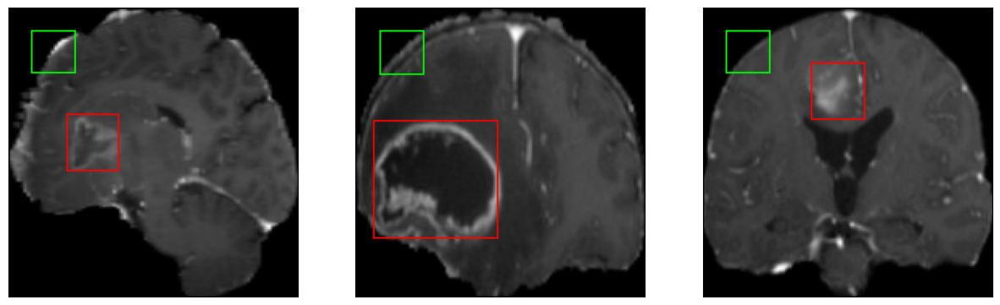

52/52 [==============================] - 73s 264ms/step - loss: 50.0107 - IoU: 6.0079e-04 - val_loss: 36.6769 - val_IoU: 0.0062
Epoch 2/100
52/52 [==============================] - ETA: 0s - loss: 29.0184 - IoU: 0.0456
Epoch 2: val_loss improved from 36.67694 to 23.78441, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 28ms/step


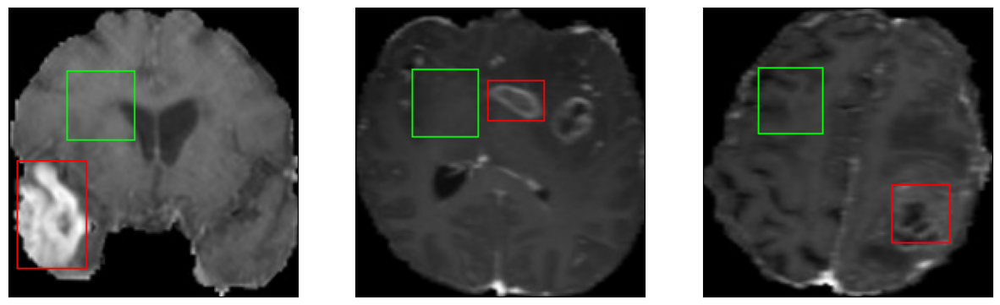

52/52 [==============================] - 11s 213ms/step - loss: 29.0184 - IoU: 0.0456 - val_loss: 23.7844 - val_IoU: 0.0911
Epoch 3/100
52/52 [==============================] - ETA: 0s - loss: 21.5883 - IoU: 0.1003
Epoch 3: val_loss improved from 23.78441 to 18.74911, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


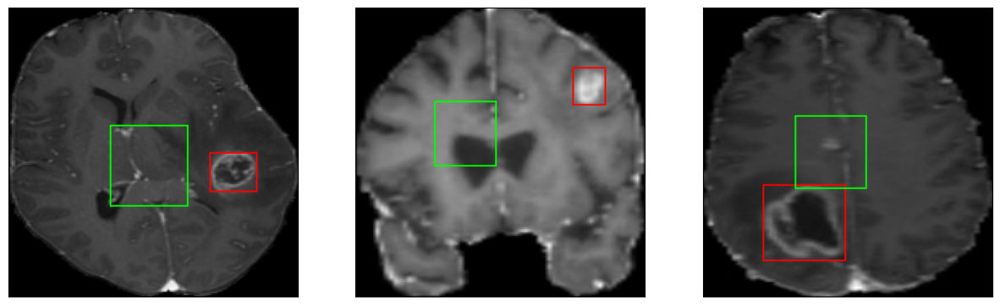

52/52 [==============================] - 8s 151ms/step - loss: 21.5883 - IoU: 0.1003 - val_loss: 18.7491 - val_IoU: 0.1325
Epoch 4/100
52/52 [==============================] - ETA: 0s - loss: 18.4901 - IoU: 0.1273
Epoch 4: val_loss improved from 18.74911 to 17.38025, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 28ms/step


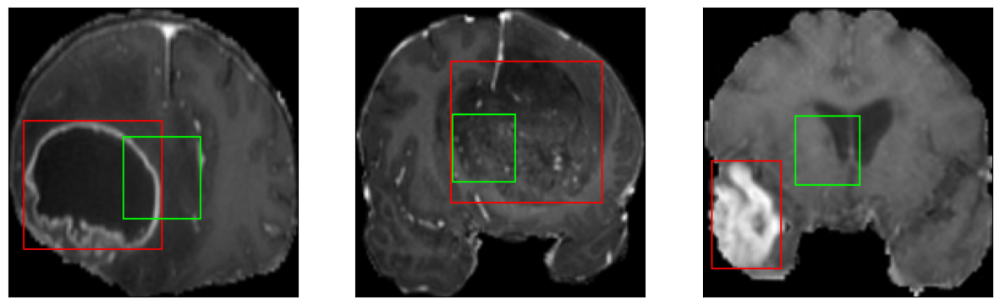

52/52 [==============================] - 7s 139ms/step - loss: 18.4901 - IoU: 0.1273 - val_loss: 17.3802 - val_IoU: 0.1637
Epoch 5/100
52/52 [==============================] - ETA: 0s - loss: 15.1726 - IoU: 0.2041
Epoch 5: val_loss improved from 17.38025 to 13.29470, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


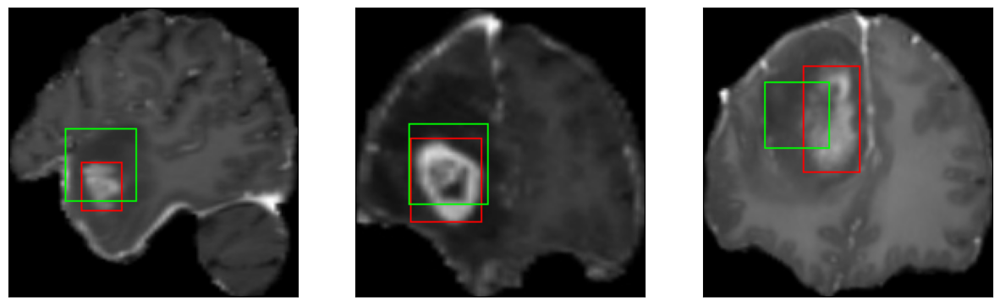

52/52 [==============================] - 8s 162ms/step - loss: 15.1726 - IoU: 0.2041 - val_loss: 13.2947 - val_IoU: 0.2514
Epoch 6/100
52/52 [==============================] - ETA: 0s - loss: 11.7128 - IoU: 0.2925
Epoch 6: val_loss improved from 13.29470 to 10.12700, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


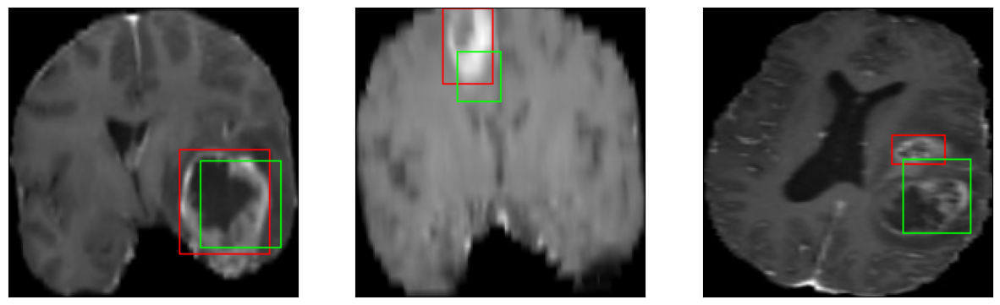

52/52 [==============================] - 8s 145ms/step - loss: 11.7128 - IoU: 0.2925 - val_loss: 10.1270 - val_IoU: 0.3488
Epoch 7/100
52/52 [==============================] - ETA: 0s - loss: 9.2403 - IoU: 0.3831
Epoch 7: val_loss improved from 10.12700 to 9.12052, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


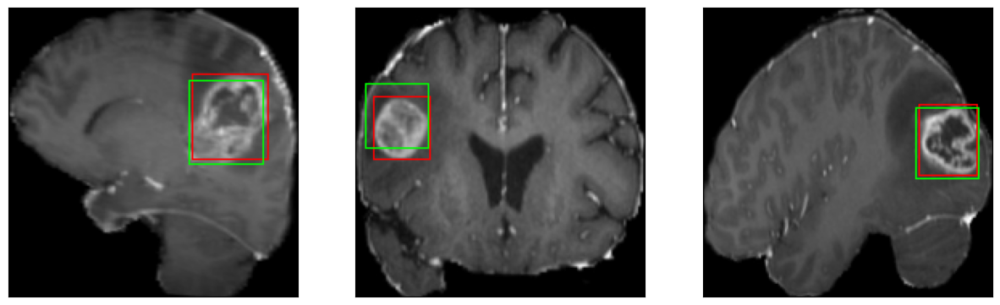

52/52 [==============================] - 7s 137ms/step - loss: 9.2403 - IoU: 0.3831 - val_loss: 9.1205 - val_IoU: 0.4191
Epoch 8/100
52/52 [==============================] - ETA: 0s - loss: 8.4516 - IoU: 0.4136
Epoch 8: val_loss improved from 9.12052 to 7.75008, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


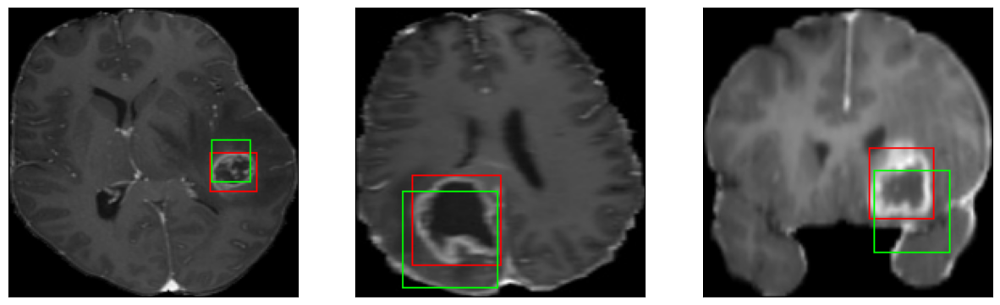

52/52 [==============================] - 8s 153ms/step - loss: 8.4516 - IoU: 0.4136 - val_loss: 7.7501 - val_IoU: 0.4732
Epoch 9/100
52/52 [==============================] - ETA: 0s - loss: 7.5376 - IoU: 0.4640
Epoch 9: val_loss did not improve from 7.75008
8/8 [==============================] - 0s 33ms/step


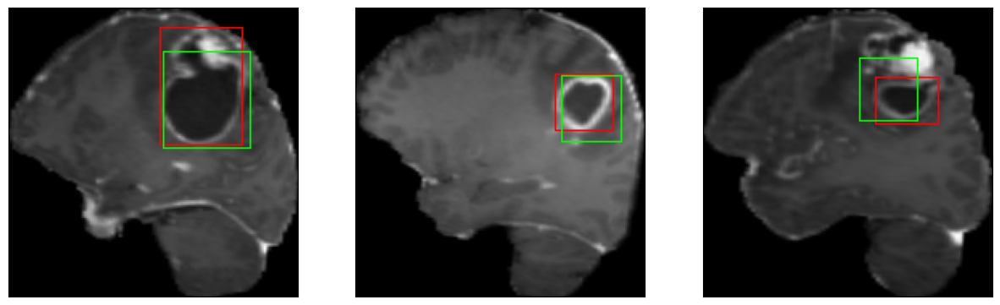

52/52 [==============================] - 6s 124ms/step - loss: 7.5376 - IoU: 0.4640 - val_loss: 8.2188 - val_IoU: 0.4710
Epoch 10/100
52/52 [==============================] - ETA: 0s - loss: 7.4186 - IoU: 0.4583
Epoch 10: val_loss improved from 7.75008 to 7.64214, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


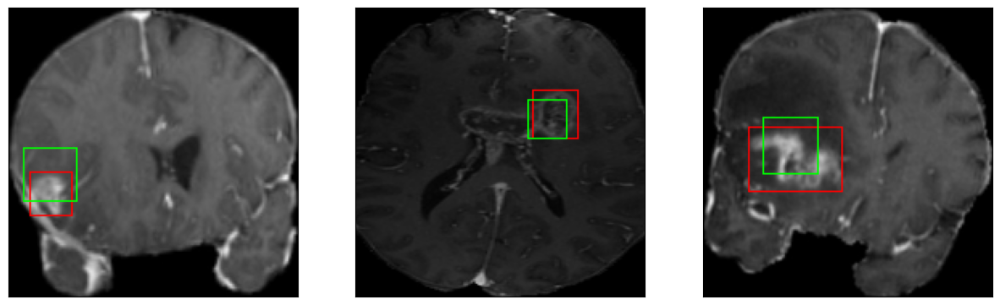

52/52 [==============================] - 8s 156ms/step - loss: 7.4186 - IoU: 0.4583 - val_loss: 7.6421 - val_IoU: 0.4472
Epoch 11/100
52/52 [==============================] - ETA: 0s - loss: 7.3009 - IoU: 0.4629
Epoch 11: val_loss did not improve from 7.64214
8/8 [==============================] - 0s 29ms/step


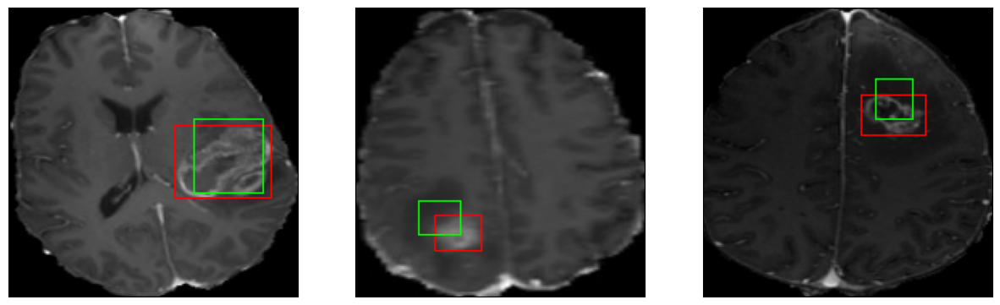

52/52 [==============================] - 6s 122ms/step - loss: 7.3009 - IoU: 0.4629 - val_loss: 8.2871 - val_IoU: 0.4213
Epoch 12/100
52/52 [==============================] - ETA: 0s - loss: 6.8411 - IoU: 0.4893
Epoch 12: val_loss improved from 7.64214 to 6.79654, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 33ms/step


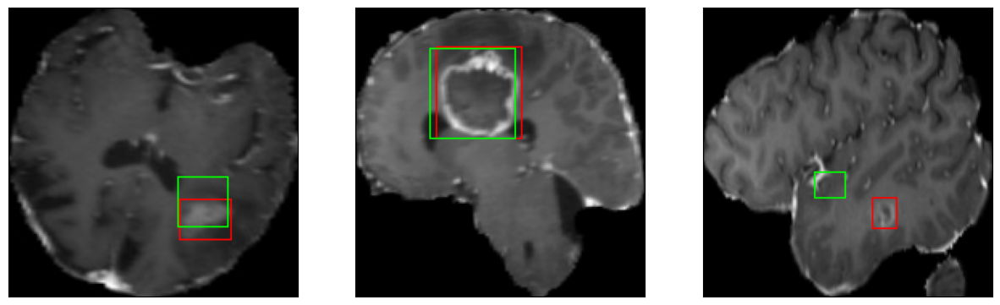

52/52 [==============================] - 8s 156ms/step - loss: 6.8411 - IoU: 0.4893 - val_loss: 6.7965 - val_IoU: 0.5286
Epoch 13/100
52/52 [==============================] - ETA: 0s - loss: 6.8350 - IoU: 0.4936
Epoch 13: val_loss did not improve from 6.79654
8/8 [==============================] - 0s 33ms/step


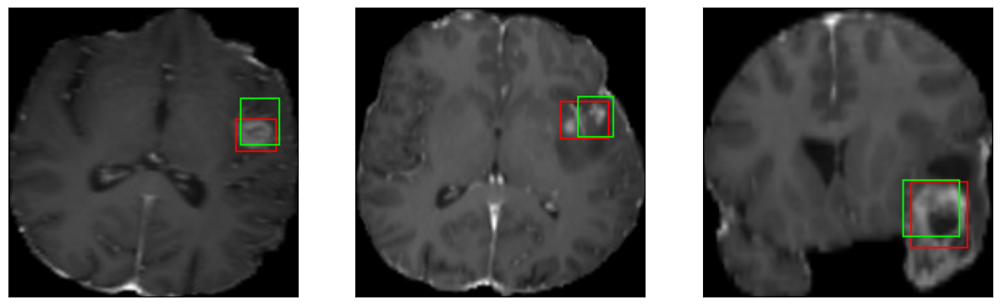

52/52 [==============================] - 6s 115ms/step - loss: 6.8350 - IoU: 0.4936 - val_loss: 6.9031 - val_IoU: 0.5070
Epoch 14/100
52/52 [==============================] - ETA: 0s - loss: 6.0273 - IoU: 0.5426
Epoch 14: val_loss did not improve from 6.79654
8/8 [==============================] - 0s 33ms/step


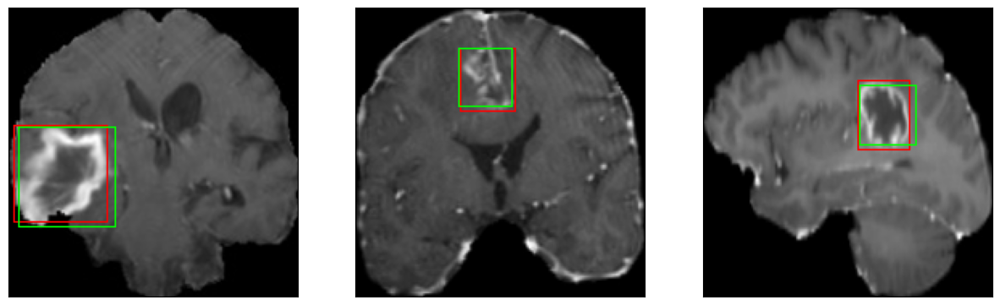

52/52 [==============================] - 6s 125ms/step - loss: 6.0273 - IoU: 0.5426 - val_loss: 6.8419 - val_IoU: 0.5512
Epoch 15/100
52/52 [==============================] - ETA: 0s - loss: 6.2962 - IoU: 0.5253
Epoch 15: val_loss improved from 6.79654 to 6.69735, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


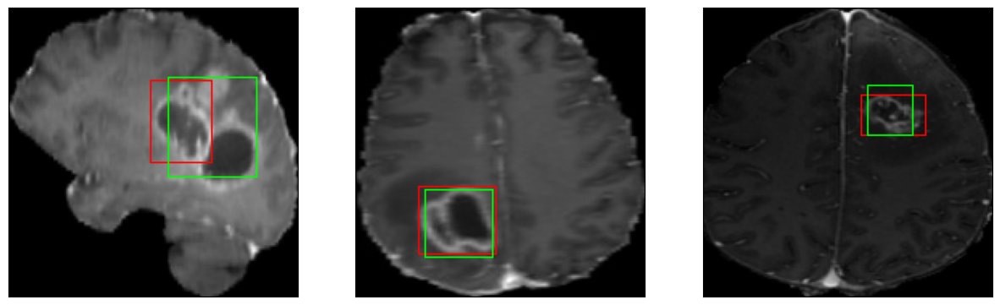

52/52 [==============================] - 9s 166ms/step - loss: 6.2962 - IoU: 0.5253 - val_loss: 6.6974 - val_IoU: 0.5339
Epoch 16/100
52/52 [==============================] - ETA: 0s - loss: 6.3064 - IoU: 0.5251
Epoch 16: val_loss did not improve from 6.69735
8/8 [==============================] - 0s 30ms/step


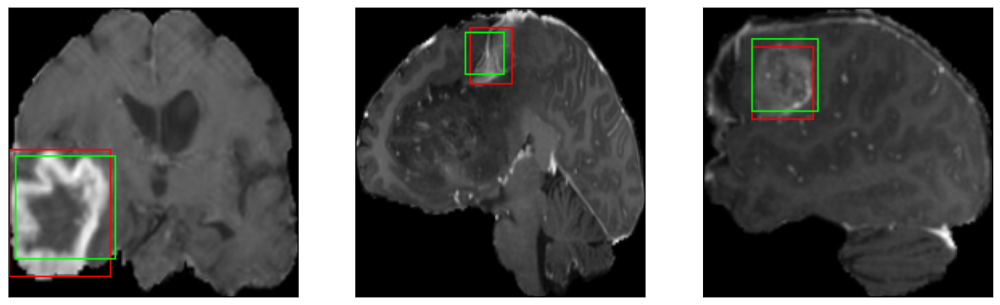

52/52 [==============================] - 7s 128ms/step - loss: 6.3064 - IoU: 0.5251 - val_loss: 6.7273 - val_IoU: 0.5322
Epoch 17/100
52/52 [==============================] - ETA: 0s - loss: 5.9509 - IoU: 0.5463
Epoch 17: val_loss improved from 6.69735 to 6.44694, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


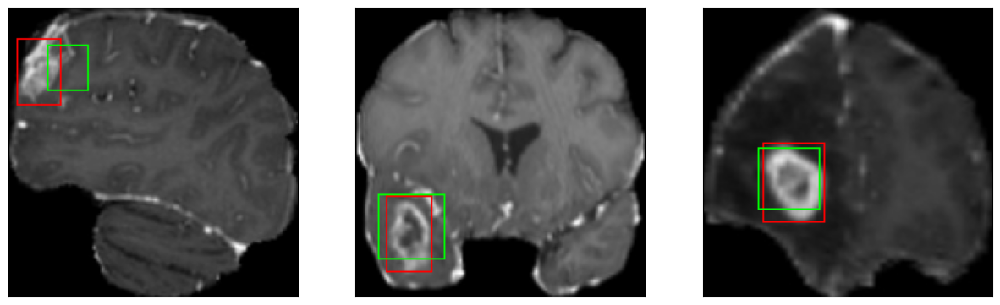

52/52 [==============================] - 9s 167ms/step - loss: 5.9509 - IoU: 0.5463 - val_loss: 6.4469 - val_IoU: 0.5694
Epoch 18/100
52/52 [==============================] - ETA: 0s - loss: 5.9402 - IoU: 0.5512
Epoch 18: val_loss did not improve from 6.44694
8/8 [==============================] - 0s 30ms/step


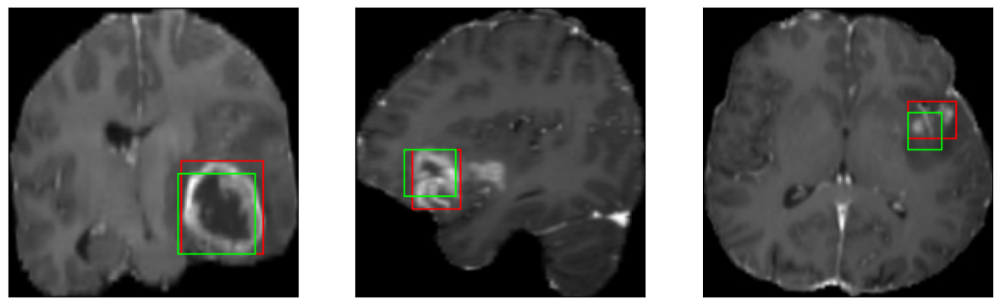

52/52 [==============================] - 6s 118ms/step - loss: 5.9402 - IoU: 0.5512 - val_loss: 7.4754 - val_IoU: 0.4641
Epoch 19/100
52/52 [==============================] - ETA: 0s - loss: 5.6998 - IoU: 0.5732
Epoch 19: val_loss improved from 6.44694 to 6.35428, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


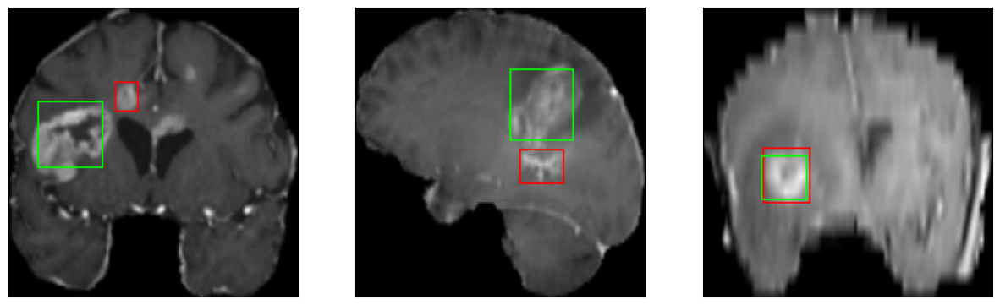

52/52 [==============================] - 8s 155ms/step - loss: 5.6998 - IoU: 0.5732 - val_loss: 6.3543 - val_IoU: 0.5442
Epoch 20/100
52/52 [==============================] - ETA: 0s - loss: 5.4563 - IoU: 0.5893
Epoch 20: val_loss improved from 6.35428 to 6.32568, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


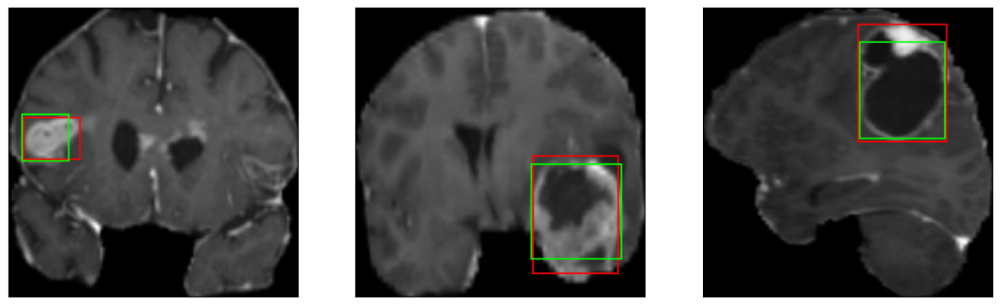

52/52 [==============================] - 9s 166ms/step - loss: 5.4563 - IoU: 0.5893 - val_loss: 6.3257 - val_IoU: 0.5709
Epoch 21/100
52/52 [==============================] - ETA: 0s - loss: 5.2799 - IoU: 0.5980
Epoch 21: val_loss did not improve from 6.32568
8/8 [==============================] - 0s 31ms/step


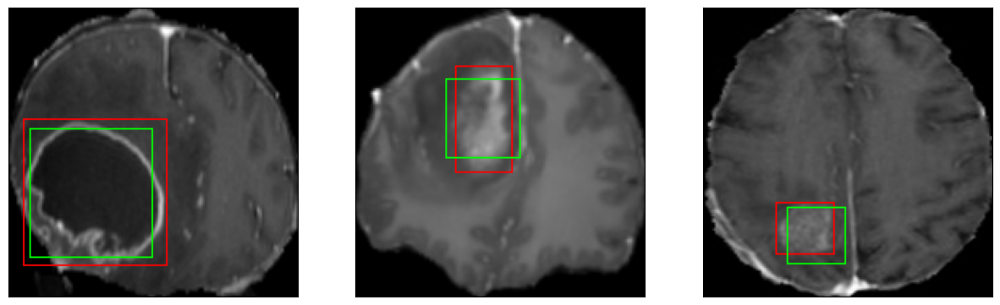

52/52 [==============================] - 6s 121ms/step - loss: 5.2799 - IoU: 0.5980 - val_loss: 6.4440 - val_IoU: 0.5592
Epoch 22/100
52/52 [==============================] - ETA: 0s - loss: 5.1534 - IoU: 0.6083
Epoch 22: val_loss did not improve from 6.32568
8/8 [==============================] - 0s 30ms/step


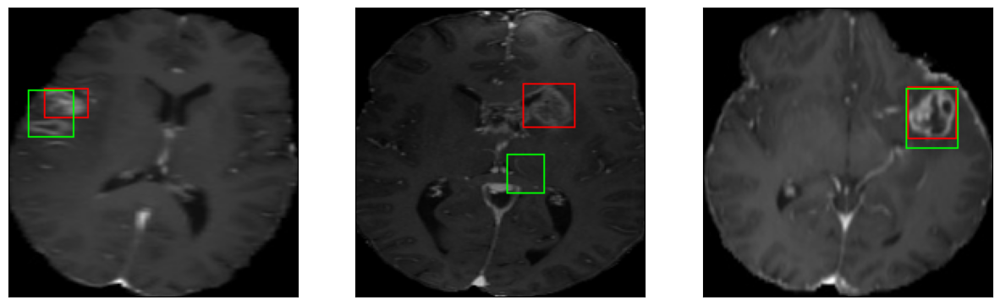

52/52 [==============================] - 7s 136ms/step - loss: 5.1534 - IoU: 0.6083 - val_loss: 6.9308 - val_IoU: 0.5479
Epoch 23/100
52/52 [==============================] - ETA: 0s - loss: 5.4901 - IoU: 0.5760
Epoch 23: val_loss did not improve from 6.32568
8/8 [==============================] - 0s 30ms/step


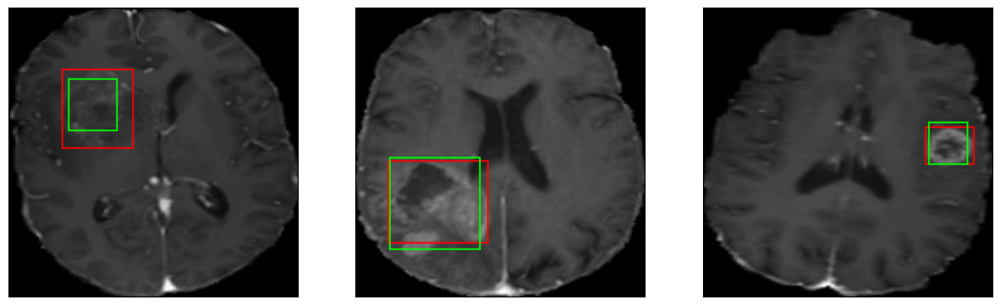

52/52 [==============================] - 6s 119ms/step - loss: 5.4901 - IoU: 0.5760 - val_loss: 6.7525 - val_IoU: 0.5264
Epoch 24/100
52/52 [==============================] - ETA: 0s - loss: 5.2994 - IoU: 0.6104
Epoch 24: val_loss did not improve from 6.32568
8/8 [==============================] - 0s 31ms/step


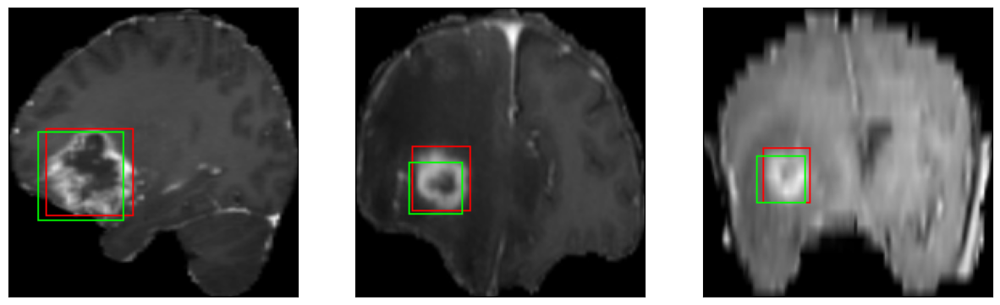

52/52 [==============================] - 7s 136ms/step - loss: 5.2994 - IoU: 0.6104 - val_loss: 6.5999 - val_IoU: 0.5302
Epoch 25/100
52/52 [==============================] - ETA: 0s - loss: 5.0867 - IoU: 0.6165
Epoch 25: val_loss did not improve from 6.32568
8/8 [==============================] - 0s 31ms/step


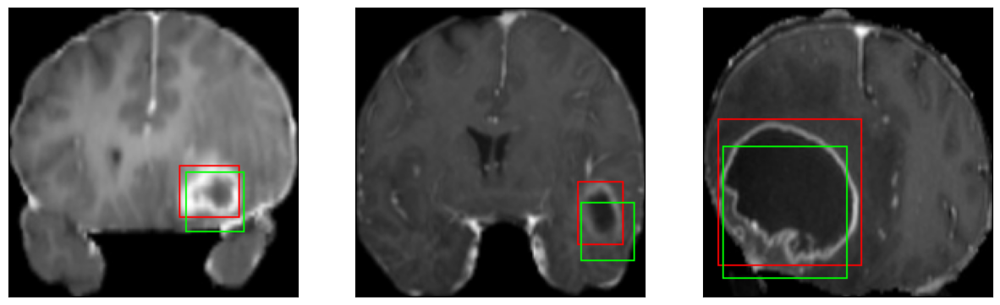

52/52 [==============================] - 6s 123ms/step - loss: 5.0867 - IoU: 0.6165 - val_loss: 6.9333 - val_IoU: 0.5174
Epoch 26/100
52/52 [==============================] - ETA: 0s - loss: 4.8407 - IoU: 0.6319
Epoch 26: val_loss did not improve from 6.32568
8/8 [==============================] - 0s 32ms/step


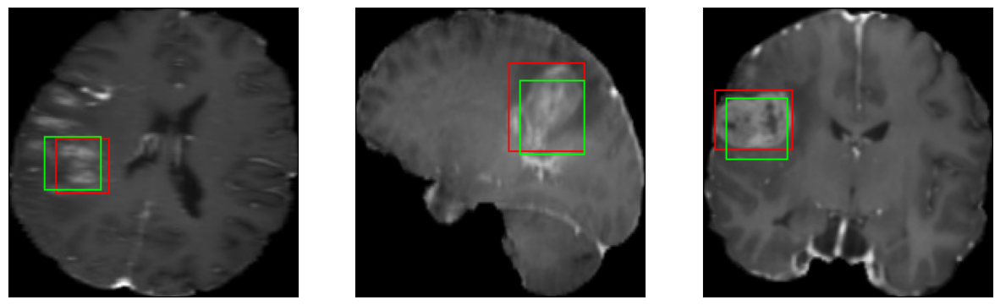

52/52 [==============================] - 7s 132ms/step - loss: 4.8407 - IoU: 0.6319 - val_loss: 6.6611 - val_IoU: 0.5448
Epoch 27/100
52/52 [==============================] - ETA: 0s - loss: 4.9288 - IoU: 0.6229
Epoch 27: val_loss did not improve from 6.32568
8/8 [==============================] - 0s 30ms/step


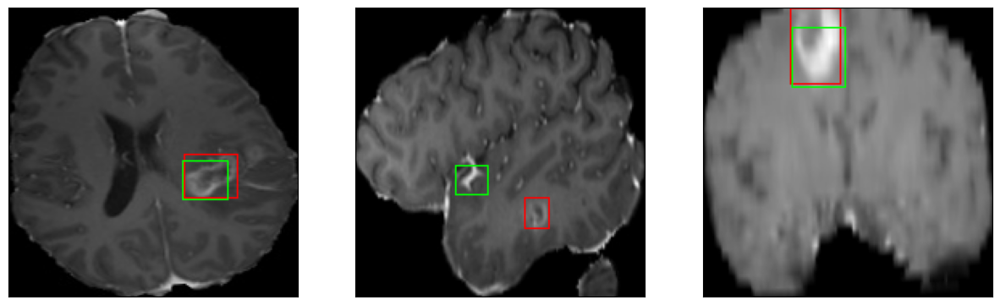

52/52 [==============================] - 6s 123ms/step - loss: 4.9288 - IoU: 0.6229 - val_loss: 6.6752 - val_IoU: 0.5448
Epoch 28/100
52/52 [==============================] - ETA: 0s - loss: 4.9463 - IoU: 0.6151
Epoch 28: val_loss did not improve from 6.32568
8/8 [==============================] - 0s 31ms/step


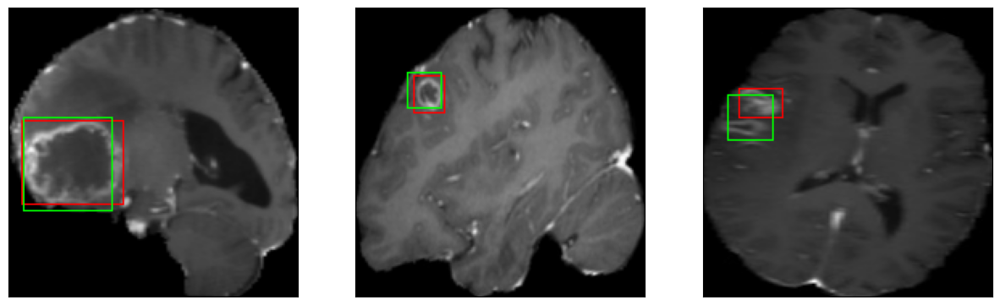

52/52 [==============================] - 8s 150ms/step - loss: 4.9463 - IoU: 0.6151 - val_loss: 6.3592 - val_IoU: 0.5717
Epoch 29/100
52/52 [==============================] - ETA: 0s - loss: 4.9414 - IoU: 0.6159
Epoch 29: val_loss improved from 6.32568 to 5.76071, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


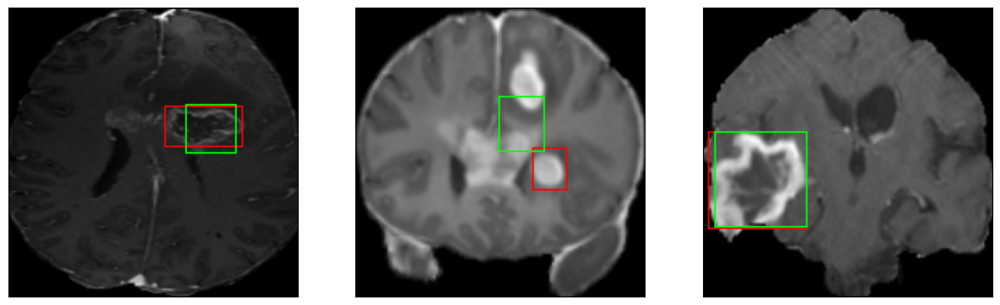

52/52 [==============================] - 9s 166ms/step - loss: 4.9414 - IoU: 0.6159 - val_loss: 5.7607 - val_IoU: 0.6049
Epoch 30/100
52/52 [==============================] - ETA: 0s - loss: 4.3879 - IoU: 0.6558
Epoch 30: val_loss did not improve from 5.76071
8/8 [==============================] - 0s 31ms/step


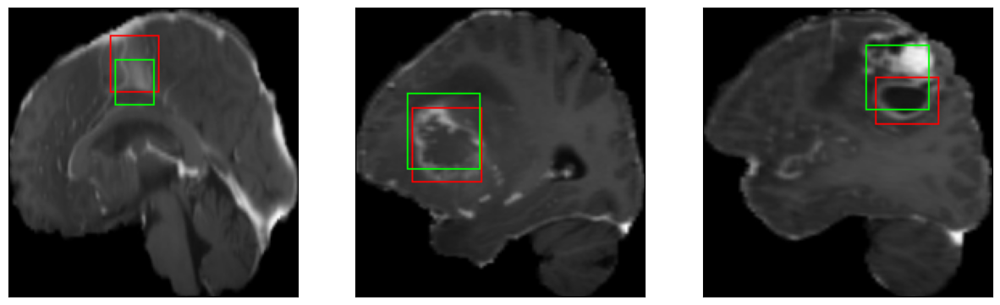

52/52 [==============================] - 6s 123ms/step - loss: 4.3879 - IoU: 0.6558 - val_loss: 6.2769 - val_IoU: 0.5507
Epoch 31/100
52/52 [==============================] - ETA: 0s - loss: 4.3532 - IoU: 0.6607
Epoch 31: val_loss did not improve from 5.76071
8/8 [==============================] - 0s 30ms/step


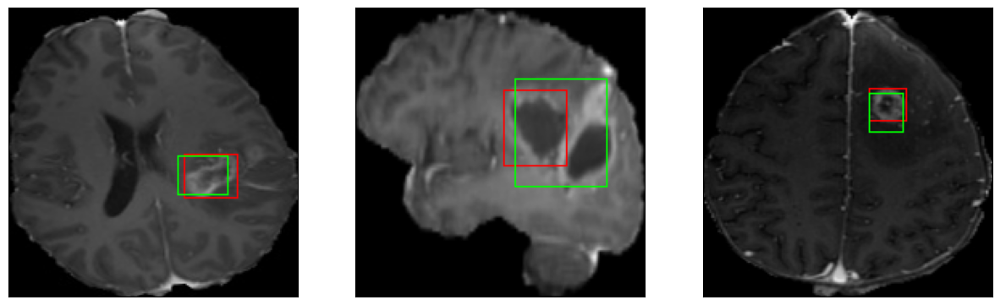

52/52 [==============================] - 7s 135ms/step - loss: 4.3532 - IoU: 0.6607 - val_loss: 6.1782 - val_IoU: 0.5693
Epoch 32/100
52/52 [==============================] - ETA: 0s - loss: 4.2054 - IoU: 0.6656
Epoch 32: val_loss did not improve from 5.76071
8/8 [==============================] - 0s 30ms/step


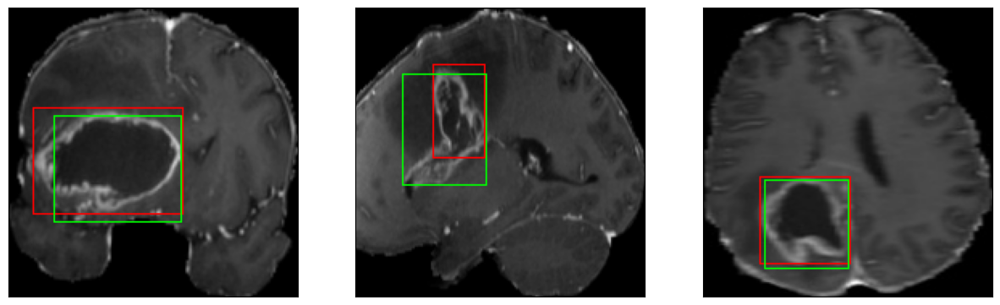

52/52 [==============================] - 7s 128ms/step - loss: 4.2054 - IoU: 0.6656 - val_loss: 6.0450 - val_IoU: 0.5965
Epoch 33/100
52/52 [==============================] - ETA: 0s - loss: 4.0368 - IoU: 0.6759
Epoch 33: val_loss did not improve from 5.76071
8/8 [==============================] - 0s 32ms/step


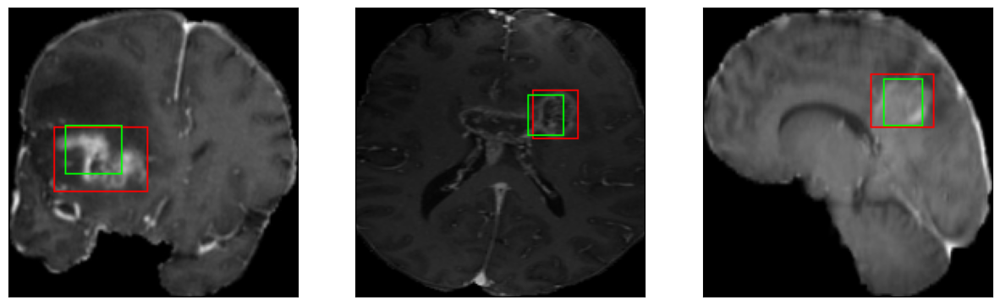

52/52 [==============================] - 7s 140ms/step - loss: 4.0368 - IoU: 0.6759 - val_loss: 6.4834 - val_IoU: 0.5393
Epoch 34/100
52/52 [==============================] - ETA: 0s - loss: 4.0739 - IoU: 0.6707
Epoch 34: val_loss did not improve from 5.76071
8/8 [==============================] - 0s 31ms/step


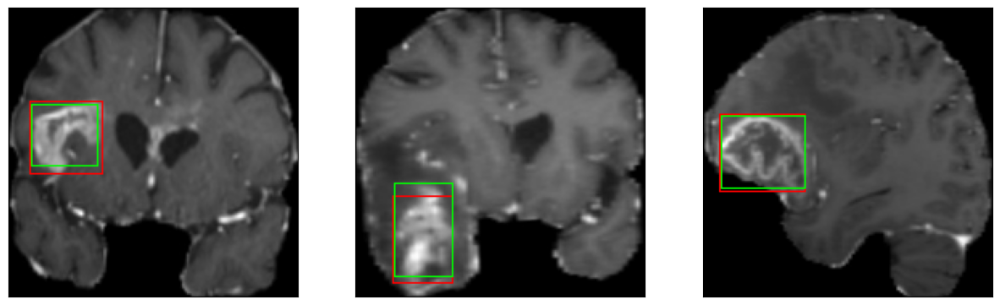

52/52 [==============================] - 7s 127ms/step - loss: 4.0739 - IoU: 0.6707 - val_loss: 5.8715 - val_IoU: 0.6152
Epoch 35/100
52/52 [==============================] - ETA: 0s - loss: 3.9498 - IoU: 0.6818
Epoch 35: val_loss improved from 5.76071 to 5.60086, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


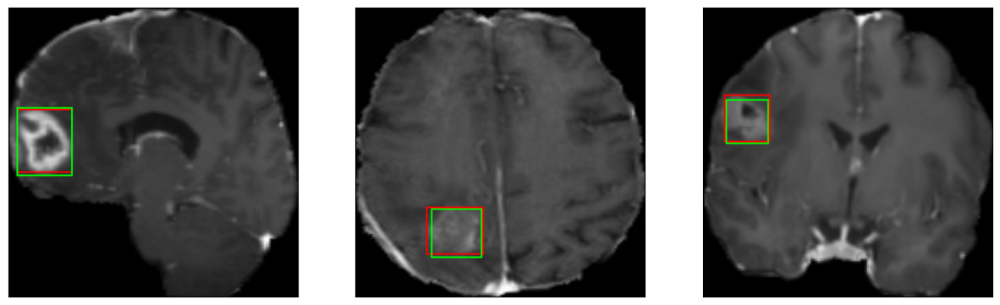

52/52 [==============================] - 9s 180ms/step - loss: 3.9498 - IoU: 0.6818 - val_loss: 5.6009 - val_IoU: 0.6178
Epoch 36/100
52/52 [==============================] - ETA: 0s - loss: 3.7405 - IoU: 0.7007
Epoch 36: val_loss improved from 5.60086 to 5.44084, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


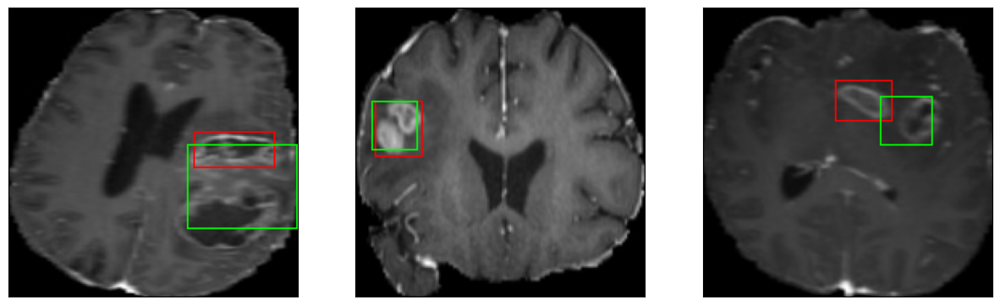

52/52 [==============================] - 8s 160ms/step - loss: 3.7405 - IoU: 0.7007 - val_loss: 5.4408 - val_IoU: 0.6269
Epoch 37/100
52/52 [==============================] - ETA: 0s - loss: 4.1067 - IoU: 0.6692
Epoch 37: val_loss did not improve from 5.44084
8/8 [==============================] - 0s 34ms/step


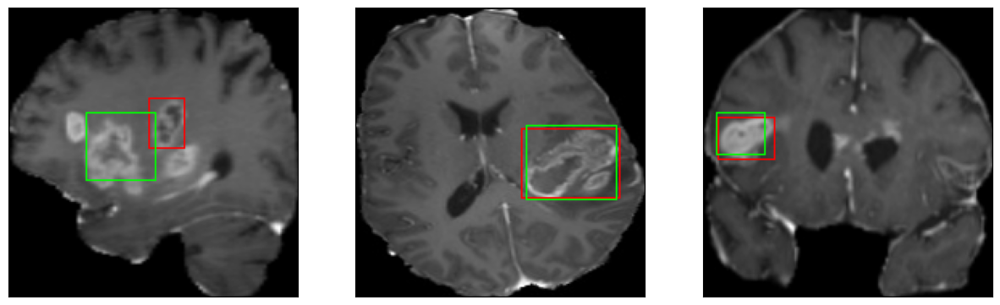

52/52 [==============================] - 7s 126ms/step - loss: 4.1067 - IoU: 0.6692 - val_loss: 6.0353 - val_IoU: 0.5775
Epoch 38/100
52/52 [==============================] - ETA: 0s - loss: 4.0188 - IoU: 0.6860
Epoch 38: val_loss did not improve from 5.44084
8/8 [==============================] - 0s 33ms/step


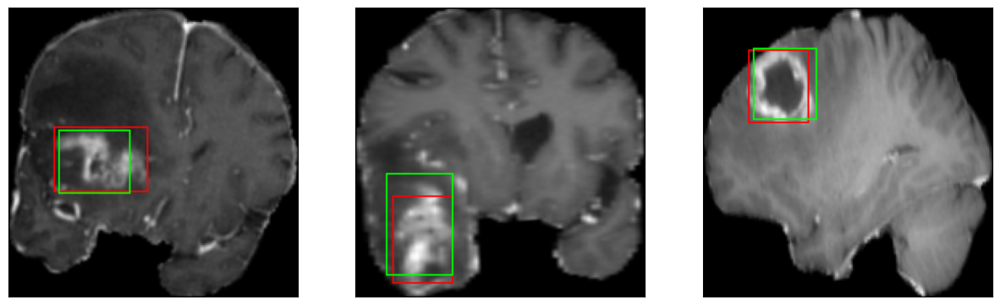

52/52 [==============================] - 7s 138ms/step - loss: 4.0188 - IoU: 0.6860 - val_loss: 5.5936 - val_IoU: 0.6326
Epoch 39/100
52/52 [==============================] - ETA: 0s - loss: 3.9559 - IoU: 0.6802
Epoch 39: val_loss did not improve from 5.44084
8/8 [==============================] - 0s 31ms/step


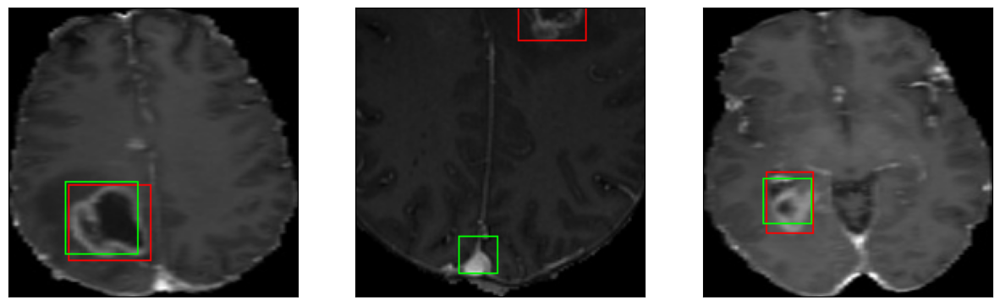

52/52 [==============================] - 7s 129ms/step - loss: 3.9559 - IoU: 0.6802 - val_loss: 6.1875 - val_IoU: 0.5300
Epoch 40/100
52/52 [==============================] - ETA: 0s - loss: 3.7348 - IoU: 0.7023
Epoch 40: val_loss did not improve from 5.44084
8/8 [==============================] - 0s 30ms/step


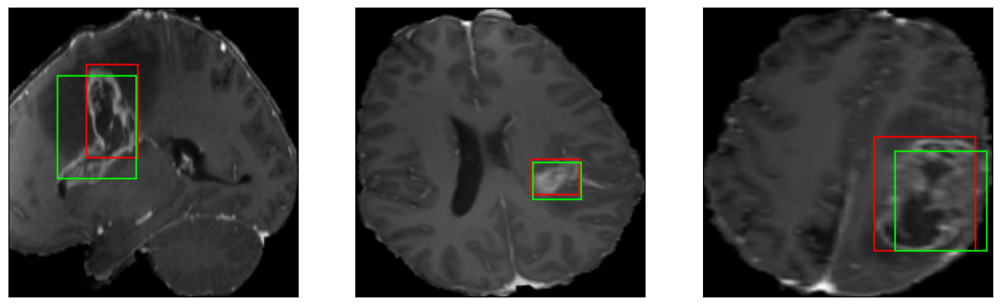

52/52 [==============================] - 7s 128ms/step - loss: 3.7348 - IoU: 0.7023 - val_loss: 5.7210 - val_IoU: 0.6299
Epoch 41/100
52/52 [==============================] - ETA: 0s - loss: 3.5588 - IoU: 0.7211
Epoch 41: val_loss improved from 5.44084 to 5.30402, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


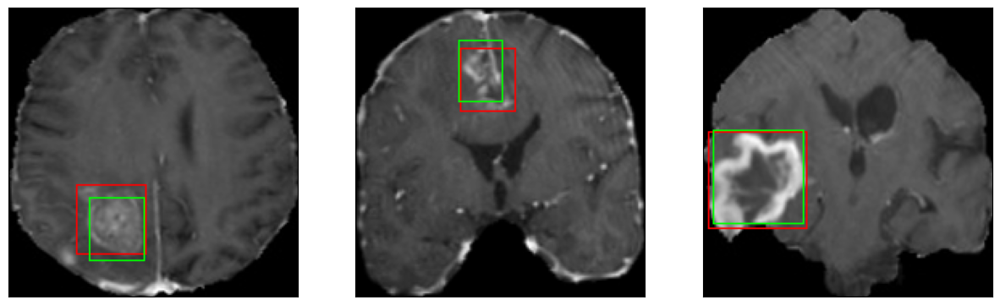

52/52 [==============================] - 9s 182ms/step - loss: 3.5588 - IoU: 0.7211 - val_loss: 5.3040 - val_IoU: 0.6446
Epoch 42/100
52/52 [==============================] - ETA: 0s - loss: 3.6482 - IoU: 0.7083
Epoch 42: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 31ms/step


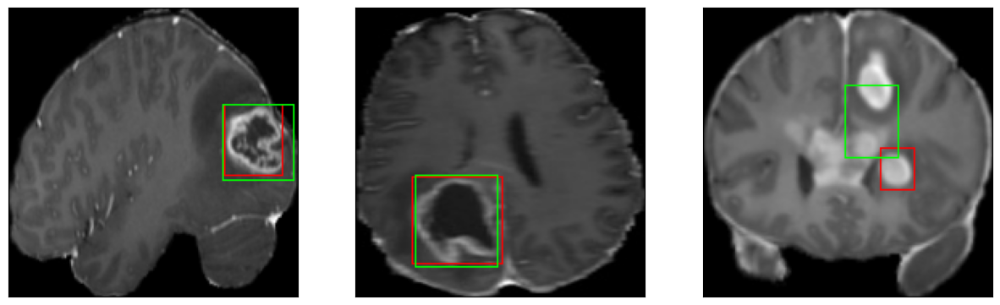

52/52 [==============================] - 6s 125ms/step - loss: 3.6482 - IoU: 0.7083 - val_loss: 5.6783 - val_IoU: 0.6273
Epoch 43/100
52/52 [==============================] - ETA: 0s - loss: 3.4739 - IoU: 0.7202
Epoch 43: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 30ms/step


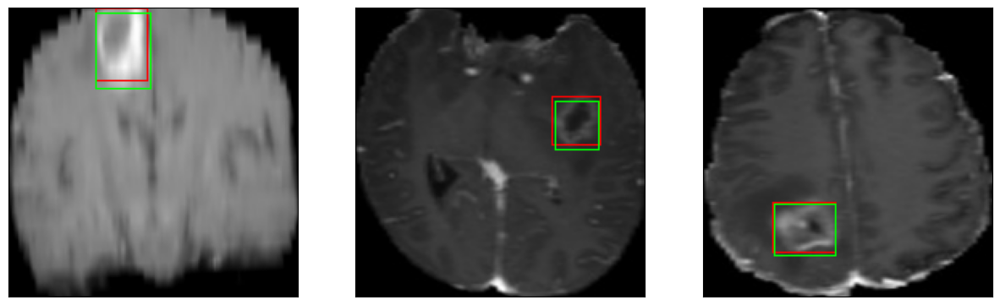

52/52 [==============================] - 7s 136ms/step - loss: 3.4739 - IoU: 0.7202 - val_loss: 5.4630 - val_IoU: 0.6338
Epoch 44/100
52/52 [==============================] - ETA: 0s - loss: 3.3299 - IoU: 0.7312
Epoch 44: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 32ms/step


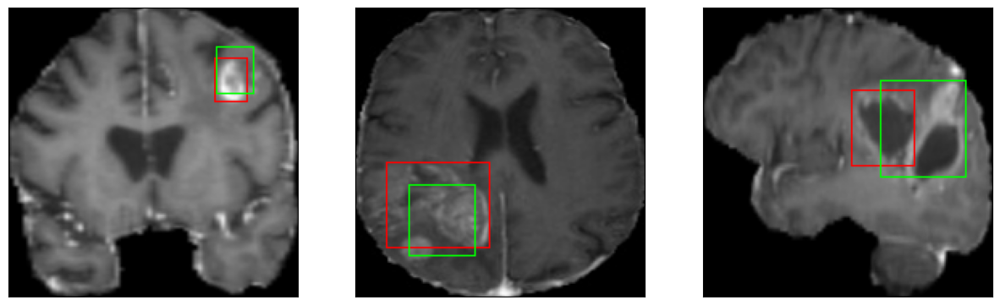

52/52 [==============================] - 7s 140ms/step - loss: 3.3299 - IoU: 0.7312 - val_loss: 5.3787 - val_IoU: 0.6446
Epoch 45/100
52/52 [==============================] - ETA: 0s - loss: 3.7662 - IoU: 0.7058
Epoch 45: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 31ms/step


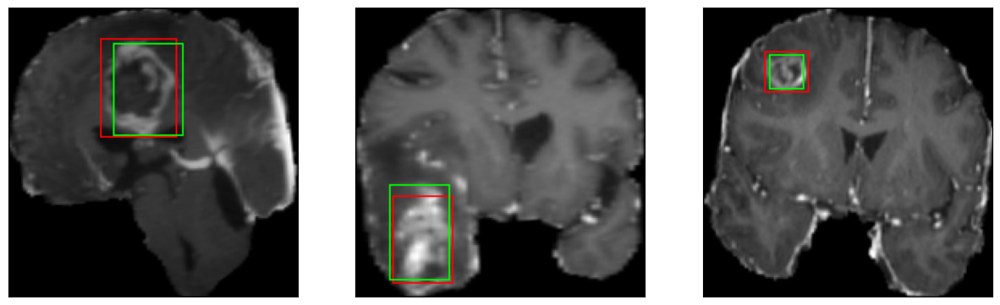

52/52 [==============================] - 7s 127ms/step - loss: 3.7662 - IoU: 0.7058 - val_loss: 5.4699 - val_IoU: 0.6290
Epoch 46/100
52/52 [==============================] - ETA: 0s - loss: 3.5719 - IoU: 0.7117
Epoch 46: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 31ms/step


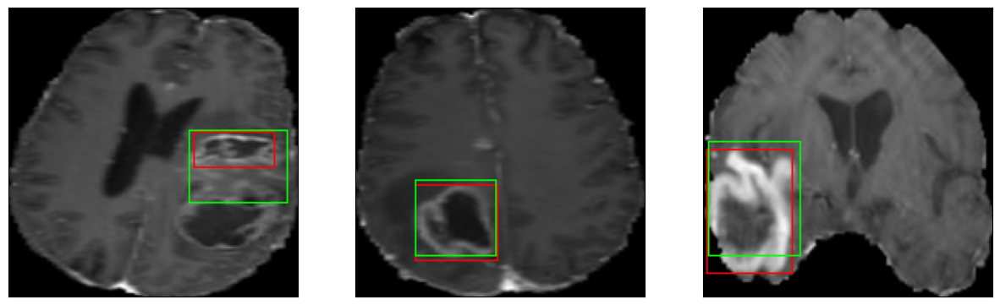

52/52 [==============================] - 7s 137ms/step - loss: 3.5719 - IoU: 0.7117 - val_loss: 5.7965 - val_IoU: 0.5832
Epoch 47/100
52/52 [==============================] - ETA: 0s - loss: 3.4625 - IoU: 0.7189
Epoch 47: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 31ms/step


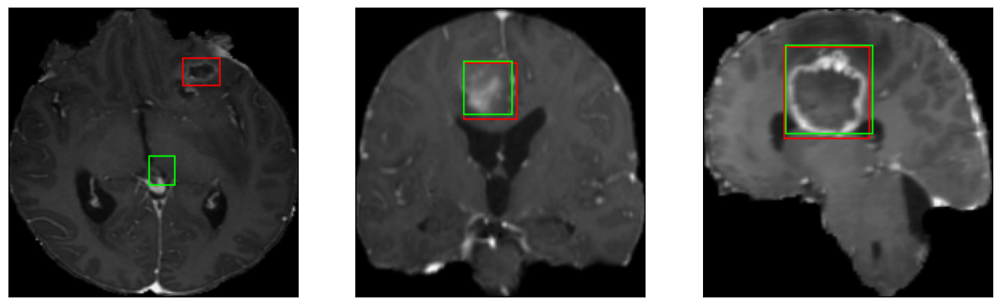

52/52 [==============================] - 7s 125ms/step - loss: 3.4625 - IoU: 0.7189 - val_loss: 5.4623 - val_IoU: 0.6199
Epoch 48/100
52/52 [==============================] - ETA: 0s - loss: 3.4513 - IoU: 0.7139
Epoch 48: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 31ms/step


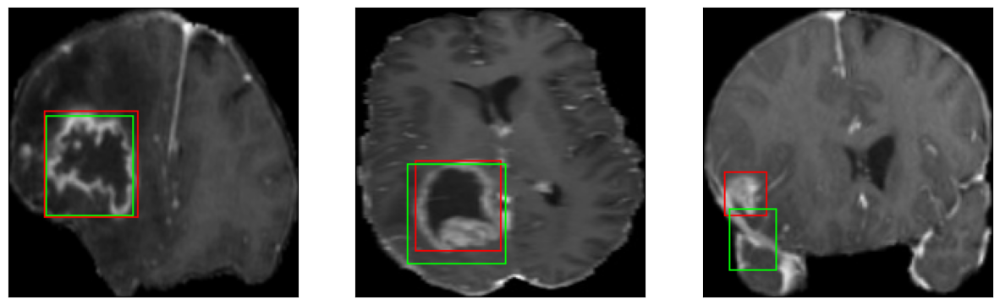

52/52 [==============================] - 7s 129ms/step - loss: 3.4513 - IoU: 0.7139 - val_loss: 5.9212 - val_IoU: 0.5932
Epoch 49/100
52/52 [==============================] - ETA: 0s - loss: 3.4266 - IoU: 0.7180
Epoch 49: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 31ms/step


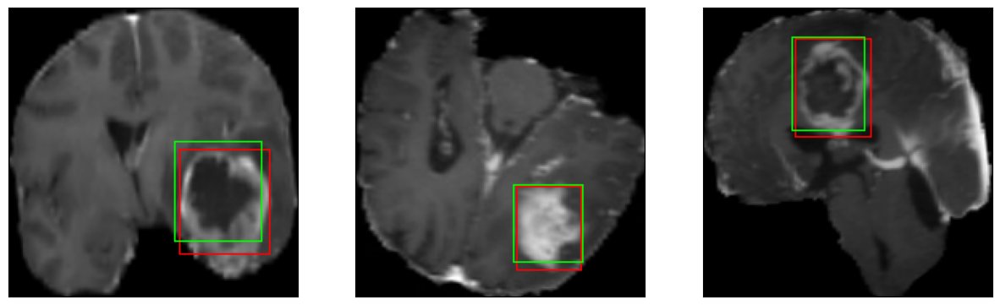

52/52 [==============================] - 7s 143ms/step - loss: 3.4266 - IoU: 0.7180 - val_loss: 5.5088 - val_IoU: 0.6108
Epoch 50/100
52/52 [==============================] - ETA: 0s - loss: 3.3846 - IoU: 0.7209
Epoch 50: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 31ms/step


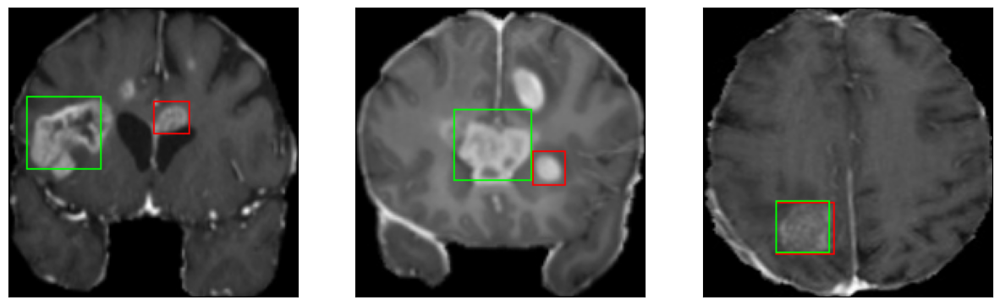

52/52 [==============================] - 7s 129ms/step - loss: 3.3846 - IoU: 0.7209 - val_loss: 5.7831 - val_IoU: 0.6006
Epoch 51/100
52/52 [==============================] - ETA: 0s - loss: 3.2670 - IoU: 0.7292
Epoch 51: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 32ms/step


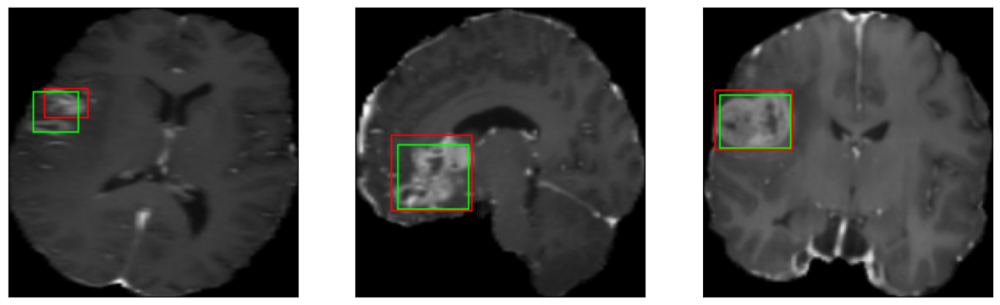

52/52 [==============================] - 7s 136ms/step - loss: 3.2670 - IoU: 0.7292 - val_loss: 5.6299 - val_IoU: 0.6267
Epoch 52/100
52/52 [==============================] - ETA: 0s - loss: 3.2173 - IoU: 0.7300
Epoch 52: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 32ms/step


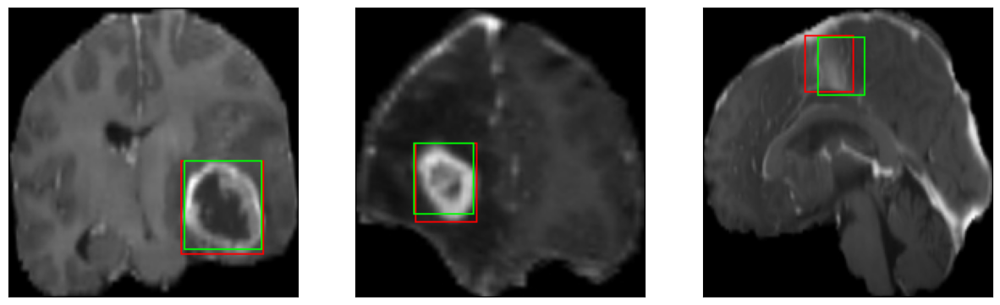

52/52 [==============================] - 7s 144ms/step - loss: 3.2173 - IoU: 0.7300 - val_loss: 5.8428 - val_IoU: 0.5829
Epoch 53/100
52/52 [==============================] - ETA: 0s - loss: 3.3205 - IoU: 0.7307
Epoch 53: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 31ms/step


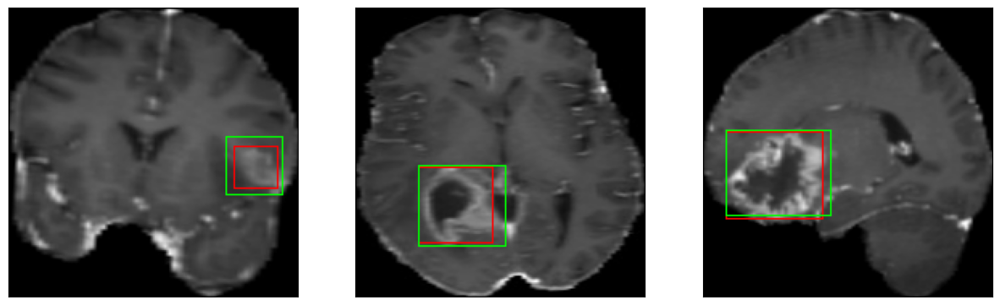

52/52 [==============================] - 7s 128ms/step - loss: 3.3205 - IoU: 0.7307 - val_loss: 5.4480 - val_IoU: 0.6249
Epoch 54/100
52/52 [==============================] - ETA: 0s - loss: 3.1966 - IoU: 0.7359
Epoch 54: val_loss did not improve from 5.30402
8/8 [==============================] - 0s 32ms/step


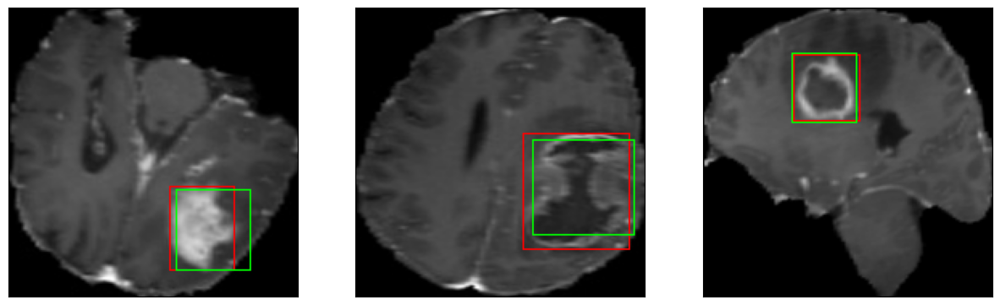

52/52 [==============================] - 7s 131ms/step - loss: 3.1966 - IoU: 0.7359 - val_loss: 6.0262 - val_IoU: 0.6057
Epoch 55/100
52/52 [==============================] - ETA: 0s - loss: 3.4065 - IoU: 0.7225
Epoch 55: val_loss improved from 5.30402 to 5.21385, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


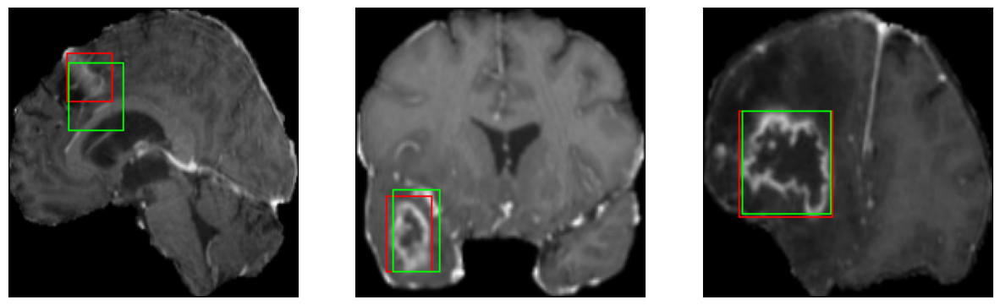

52/52 [==============================] - 9s 173ms/step - loss: 3.4065 - IoU: 0.7225 - val_loss: 5.2139 - val_IoU: 0.6472
Epoch 56/100
52/52 [==============================] - ETA: 0s - loss: 3.2704 - IoU: 0.7292
Epoch 56: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 30ms/step


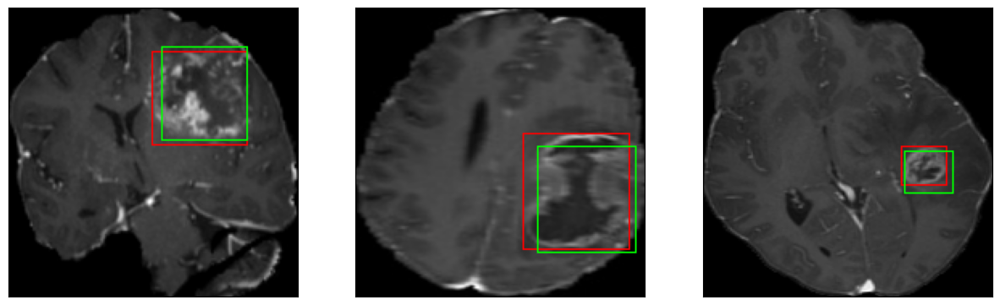

52/52 [==============================] - 7s 139ms/step - loss: 3.2704 - IoU: 0.7292 - val_loss: 5.5140 - val_IoU: 0.6422
Epoch 57/100
52/52 [==============================] - ETA: 0s - loss: 3.1661 - IoU: 0.7347
Epoch 57: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


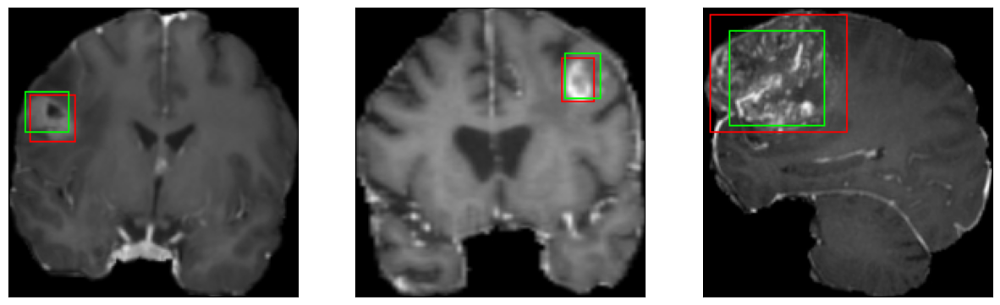

52/52 [==============================] - 7s 136ms/step - loss: 3.1661 - IoU: 0.7347 - val_loss: 5.4428 - val_IoU: 0.6140
Epoch 58/100
52/52 [==============================] - ETA: 0s - loss: 3.0093 - IoU: 0.7445
Epoch 58: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


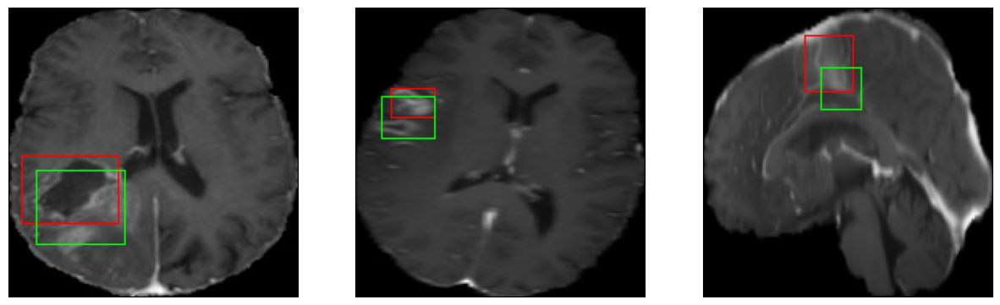

52/52 [==============================] - 8s 146ms/step - loss: 3.0093 - IoU: 0.7445 - val_loss: 5.3859 - val_IoU: 0.6460
Epoch 59/100
52/52 [==============================] - ETA: 0s - loss: 2.9791 - IoU: 0.7494
Epoch 59: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


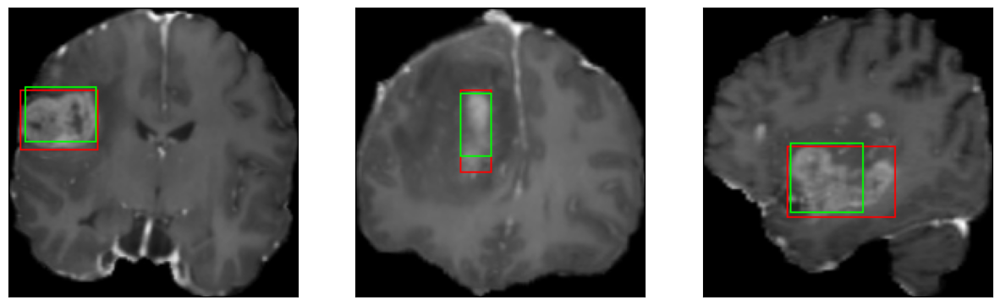

52/52 [==============================] - 7s 132ms/step - loss: 2.9791 - IoU: 0.7494 - val_loss: 5.4341 - val_IoU: 0.6261
Epoch 60/100
52/52 [==============================] - ETA: 0s - loss: 3.0335 - IoU: 0.7501
Epoch 60: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


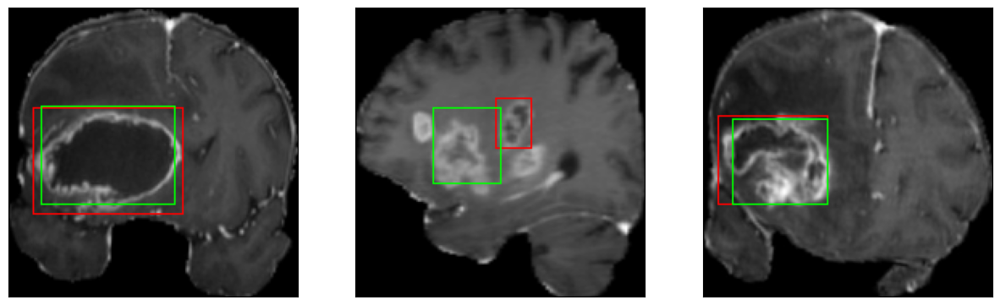

52/52 [==============================] - 7s 133ms/step - loss: 3.0335 - IoU: 0.7501 - val_loss: 5.3839 - val_IoU: 0.6220
Epoch 61/100
52/52 [==============================] - ETA: 0s - loss: 2.9780 - IoU: 0.7482
Epoch 61: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 30ms/step


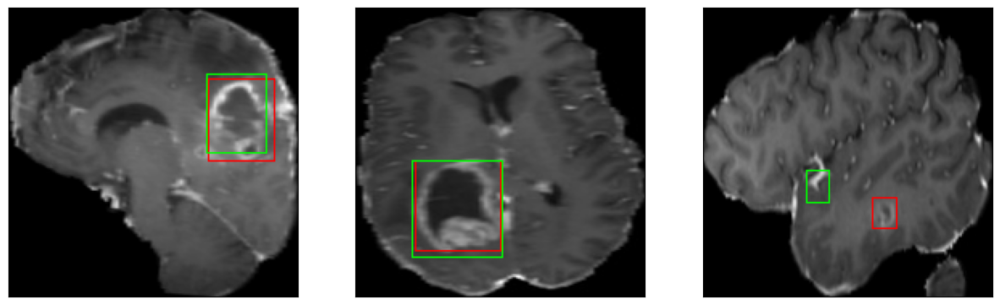

52/52 [==============================] - 7s 130ms/step - loss: 2.9780 - IoU: 0.7482 - val_loss: 5.4271 - val_IoU: 0.6276
Epoch 62/100
52/52 [==============================] - ETA: 0s - loss: 2.9815 - IoU: 0.7531
Epoch 62: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


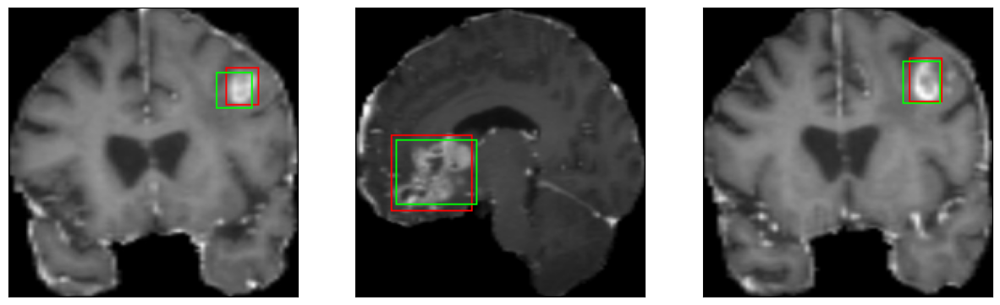

52/52 [==============================] - 8s 146ms/step - loss: 2.9815 - IoU: 0.7531 - val_loss: 5.4881 - val_IoU: 0.6333
Epoch 63/100
52/52 [==============================] - ETA: 0s - loss: 2.9507 - IoU: 0.7499
Epoch 63: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


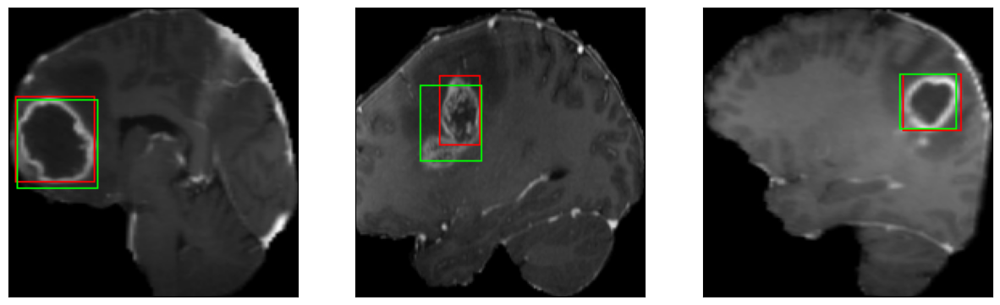

52/52 [==============================] - 7s 128ms/step - loss: 2.9507 - IoU: 0.7499 - val_loss: 5.5805 - val_IoU: 0.6198
Epoch 64/100
52/52 [==============================] - ETA: 0s - loss: 2.8372 - IoU: 0.7605
Epoch 64: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 30ms/step


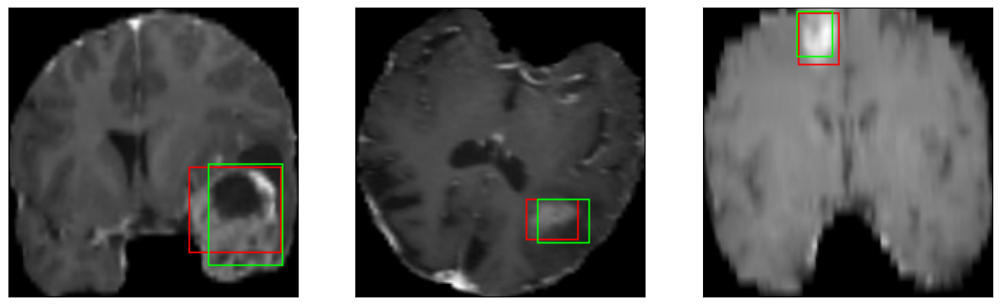

52/52 [==============================] - 7s 134ms/step - loss: 2.8372 - IoU: 0.7605 - val_loss: 5.9175 - val_IoU: 0.5832
Epoch 65/100
52/52 [==============================] - ETA: 0s - loss: 3.0291 - IoU: 0.7526
Epoch 65: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 32ms/step


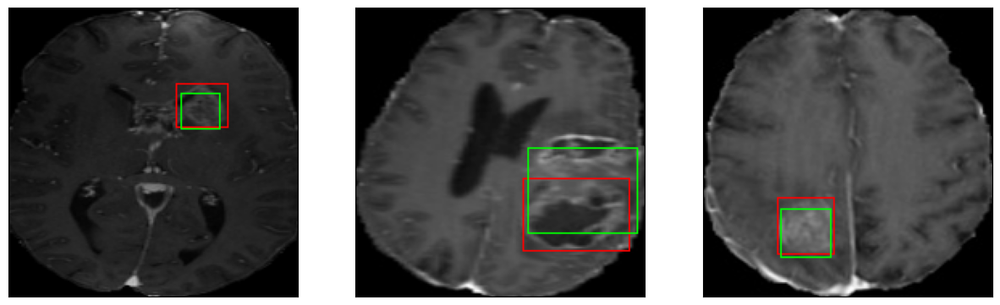

52/52 [==============================] - 7s 128ms/step - loss: 3.0291 - IoU: 0.7526 - val_loss: 5.5445 - val_IoU: 0.6306
Epoch 66/100
52/52 [==============================] - ETA: 0s - loss: 2.7267 - IoU: 0.7710
Epoch 66: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


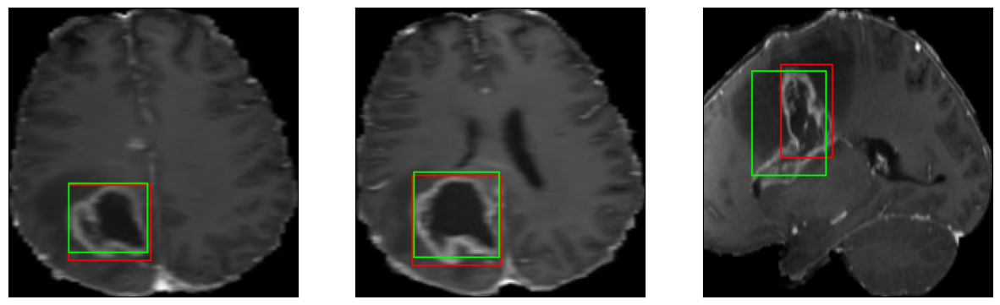

52/52 [==============================] - 7s 133ms/step - loss: 2.7267 - IoU: 0.7710 - val_loss: 5.4275 - val_IoU: 0.6406
Epoch 67/100
52/52 [==============================] - ETA: 0s - loss: 2.6946 - IoU: 0.7737
Epoch 67: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


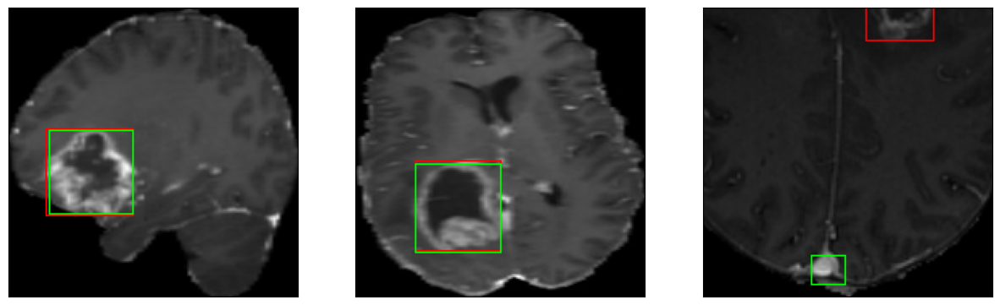

52/52 [==============================] - 6s 125ms/step - loss: 2.6946 - IoU: 0.7737 - val_loss: 5.4087 - val_IoU: 0.6328
Epoch 68/100
52/52 [==============================] - ETA: 0s - loss: 2.7081 - IoU: 0.7716
Epoch 68: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 34ms/step


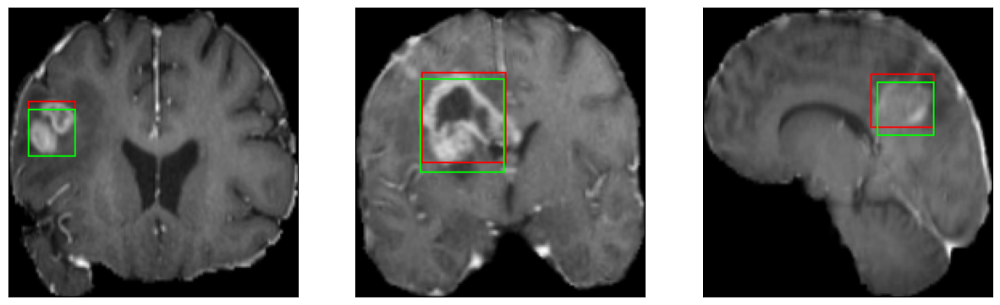

52/52 [==============================] - 7s 133ms/step - loss: 2.7081 - IoU: 0.7716 - val_loss: 5.7314 - val_IoU: 0.6112
Epoch 69/100
52/52 [==============================] - ETA: 0s - loss: 2.7337 - IoU: 0.7700
Epoch 69: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


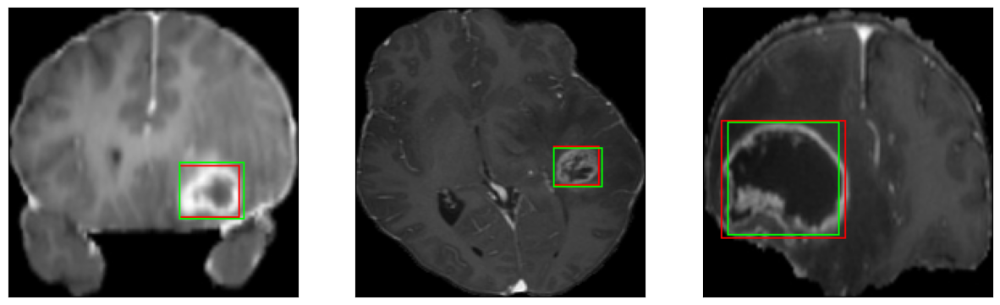

52/52 [==============================] - 7s 128ms/step - loss: 2.7337 - IoU: 0.7700 - val_loss: 5.5157 - val_IoU: 0.6323
Epoch 70/100
52/52 [==============================] - ETA: 0s - loss: 2.8731 - IoU: 0.7610
Epoch 70: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


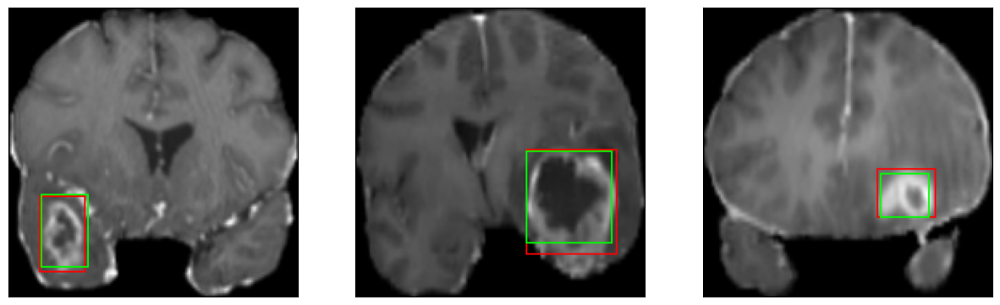

52/52 [==============================] - 7s 133ms/step - loss: 2.8731 - IoU: 0.7610 - val_loss: 5.4329 - val_IoU: 0.6420
Epoch 71/100
52/52 [==============================] - ETA: 0s - loss: 2.8062 - IoU: 0.7558
Epoch 71: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 30ms/step


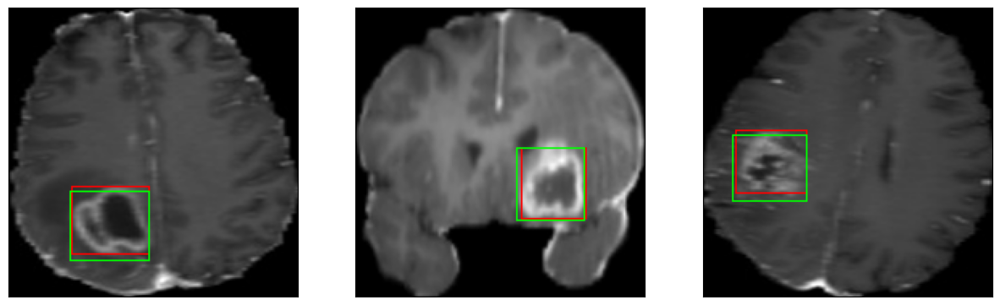

52/52 [==============================] - 7s 130ms/step - loss: 2.8062 - IoU: 0.7558 - val_loss: 5.2417 - val_IoU: 0.6631
Epoch 72/100
52/52 [==============================] - ETA: 0s - loss: 2.6927 - IoU: 0.7671
Epoch 72: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


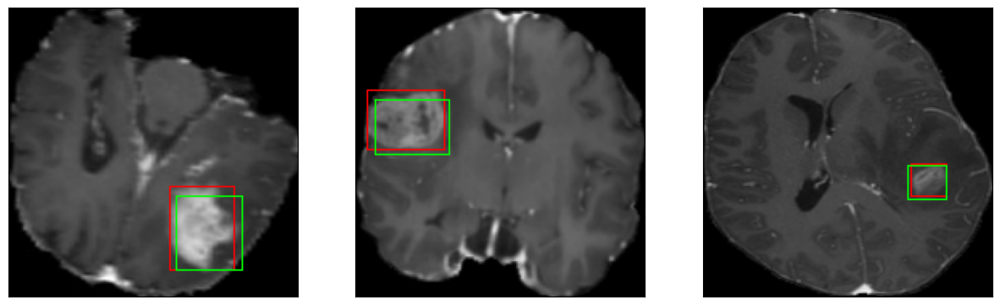

52/52 [==============================] - 7s 132ms/step - loss: 2.6927 - IoU: 0.7671 - val_loss: 5.3969 - val_IoU: 0.6342
Epoch 73/100
52/52 [==============================] - ETA: 0s - loss: 2.7353 - IoU: 0.7637
Epoch 73: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


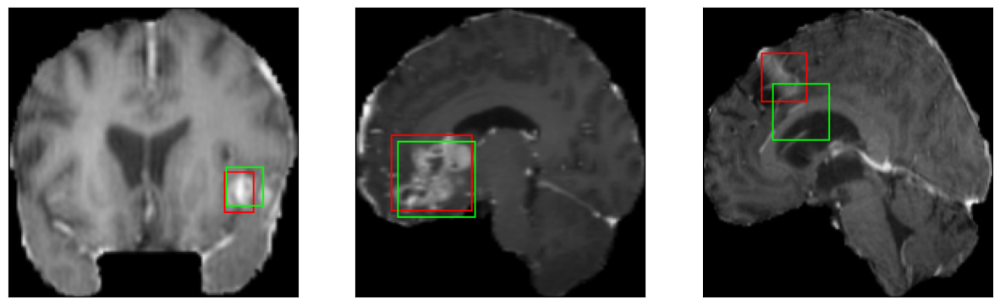

52/52 [==============================] - 6s 122ms/step - loss: 2.7353 - IoU: 0.7637 - val_loss: 5.7270 - val_IoU: 0.6418
Epoch 74/100
52/52 [==============================] - ETA: 0s - loss: 2.6721 - IoU: 0.7744
Epoch 74: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


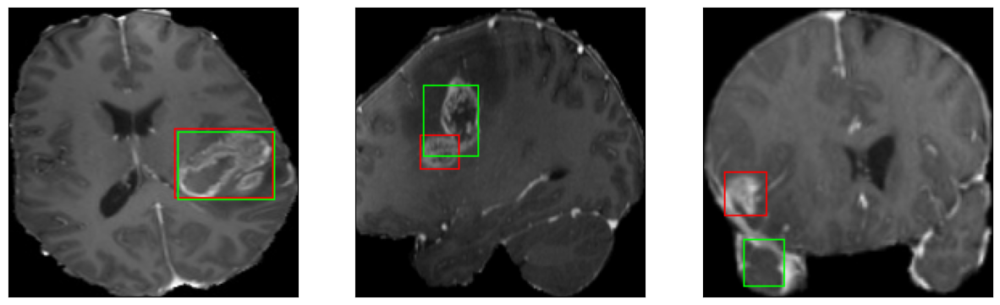

52/52 [==============================] - 7s 141ms/step - loss: 2.6721 - IoU: 0.7744 - val_loss: 5.4099 - val_IoU: 0.6457
Epoch 75/100
52/52 [==============================] - ETA: 0s - loss: 2.5473 - IoU: 0.7816
Epoch 75: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 32ms/step


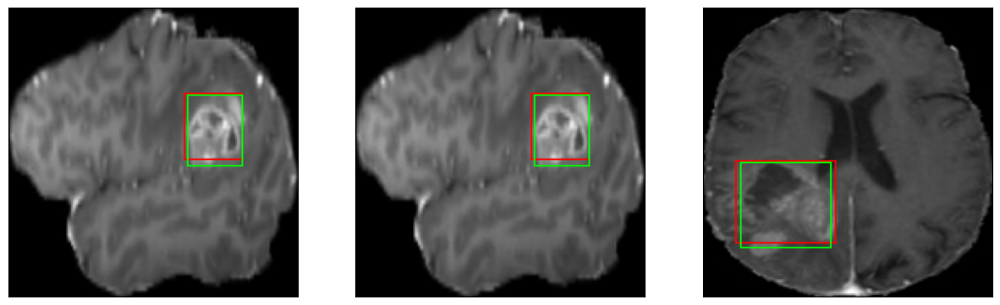

52/52 [==============================] - 7s 127ms/step - loss: 2.5473 - IoU: 0.7816 - val_loss: 5.2338 - val_IoU: 0.6585
Epoch 76/100
52/52 [==============================] - ETA: 0s - loss: 2.5309 - IoU: 0.7881
Epoch 76: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 30ms/step


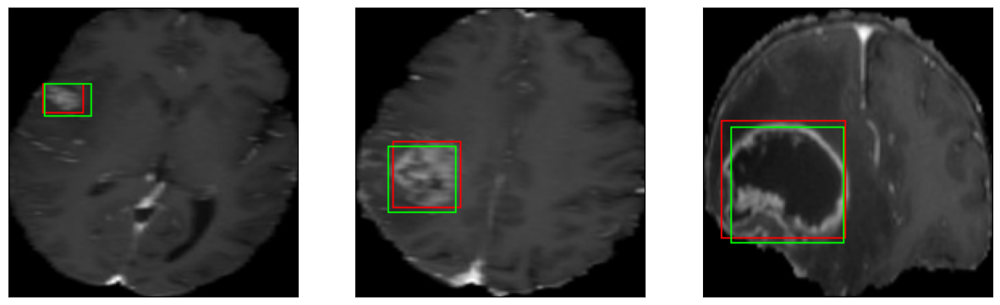

52/52 [==============================] - 6s 123ms/step - loss: 2.5309 - IoU: 0.7881 - val_loss: 5.5419 - val_IoU: 0.6406
Epoch 77/100
52/52 [==============================] - ETA: 0s - loss: 2.6387 - IoU: 0.7629
Epoch 77: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 33ms/step


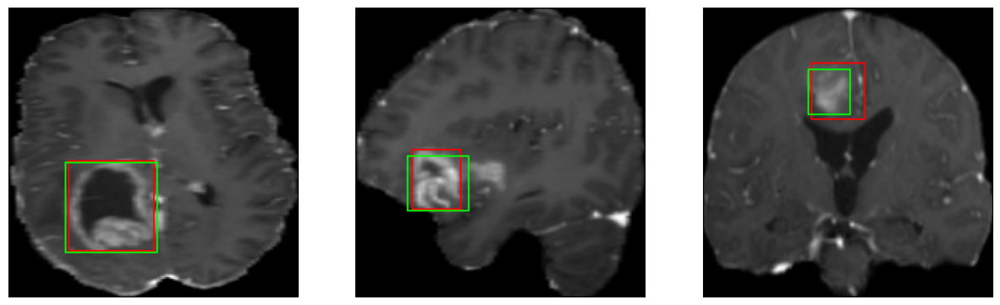

52/52 [==============================] - 7s 132ms/step - loss: 2.6387 - IoU: 0.7629 - val_loss: 5.2198 - val_IoU: 0.6585
Epoch 78/100
52/52 [==============================] - ETA: 0s - loss: 2.5295 - IoU: 0.7806
Epoch 78: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 30ms/step


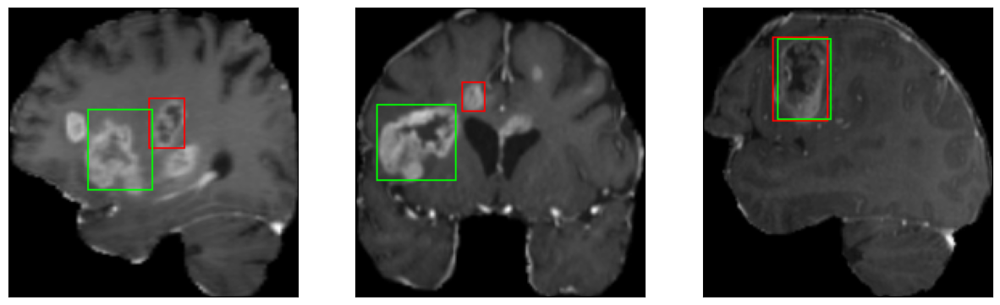

52/52 [==============================] - 6s 123ms/step - loss: 2.5295 - IoU: 0.7806 - val_loss: 5.3023 - val_IoU: 0.6564
Epoch 79/100
52/52 [==============================] - ETA: 0s - loss: 2.4089 - IoU: 0.7969
Epoch 79: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 33ms/step


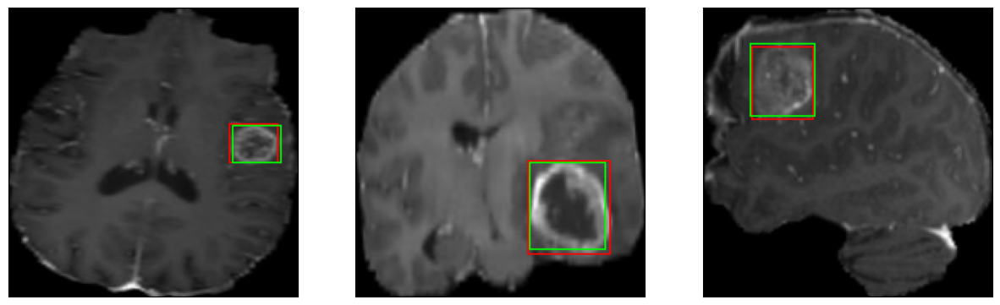

52/52 [==============================] - 7s 144ms/step - loss: 2.4089 - IoU: 0.7969 - val_loss: 5.2504 - val_IoU: 0.6552
Epoch 80/100
52/52 [==============================] - ETA: 0s - loss: 2.5011 - IoU: 0.7893
Epoch 80: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


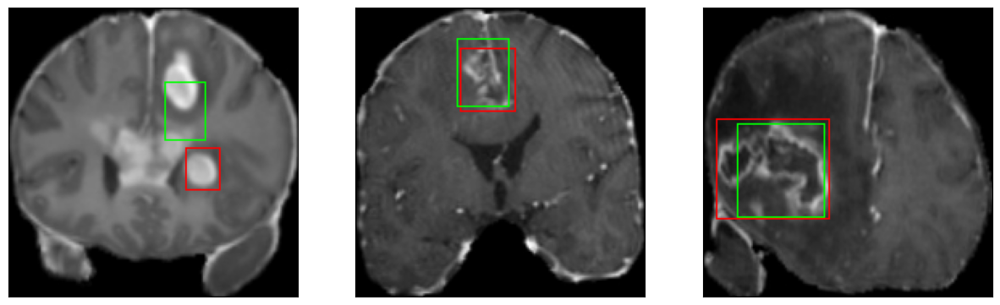

52/52 [==============================] - 6s 124ms/step - loss: 2.5011 - IoU: 0.7893 - val_loss: 5.4991 - val_IoU: 0.6374
Epoch 81/100
52/52 [==============================] - ETA: 0s - loss: 2.6622 - IoU: 0.7803
Epoch 81: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 29ms/step


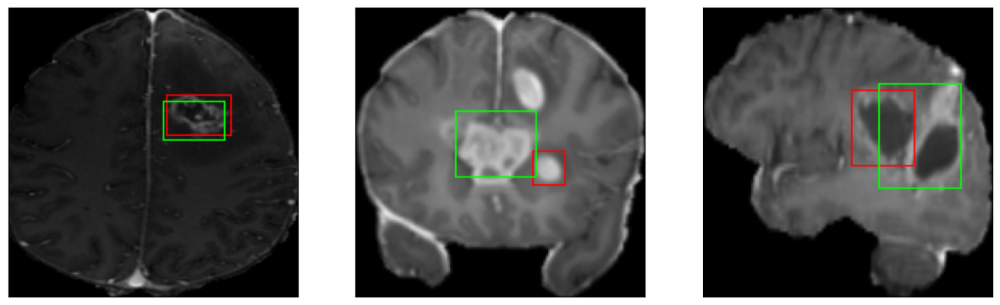

52/52 [==============================] - 7s 129ms/step - loss: 2.6622 - IoU: 0.7803 - val_loss: 5.4958 - val_IoU: 0.6435
Epoch 82/100
52/52 [==============================] - ETA: 0s - loss: 2.4440 - IoU: 0.7963
Epoch 82: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 32ms/step


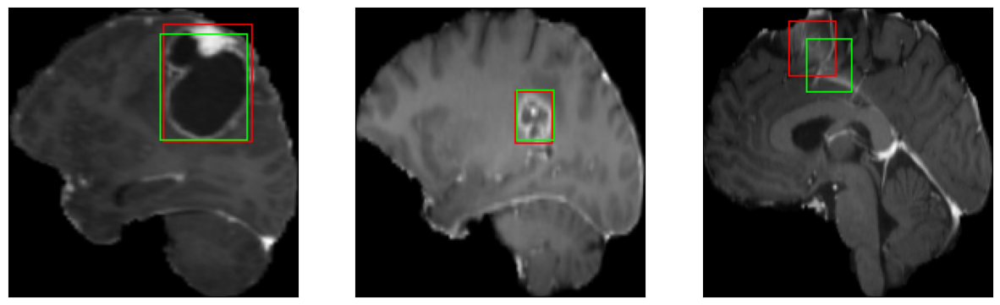

52/52 [==============================] - 7s 126ms/step - loss: 2.4440 - IoU: 0.7963 - val_loss: 5.6412 - val_IoU: 0.6354
Epoch 83/100
52/52 [==============================] - ETA: 0s - loss: 2.5048 - IoU: 0.7881
Epoch 83: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 34ms/step


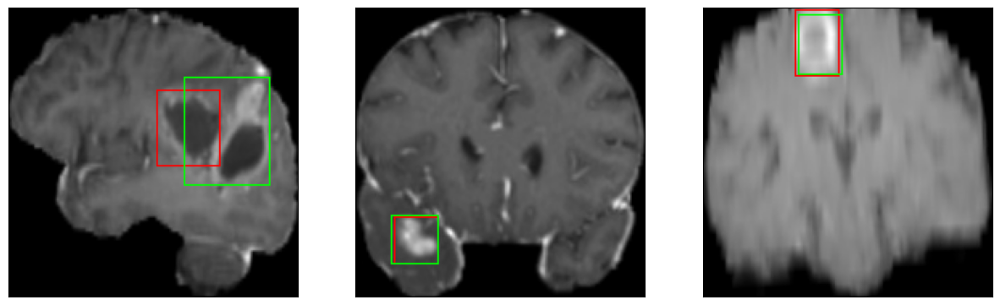

52/52 [==============================] - 7s 138ms/step - loss: 2.5048 - IoU: 0.7881 - val_loss: 5.3179 - val_IoU: 0.6599
Epoch 84/100
52/52 [==============================] - ETA: 0s - loss: 2.6232 - IoU: 0.7757
Epoch 84: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 30ms/step


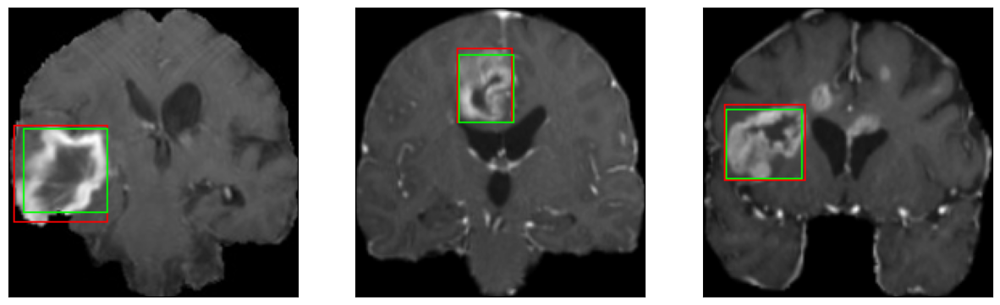

52/52 [==============================] - 7s 128ms/step - loss: 2.6232 - IoU: 0.7757 - val_loss: 5.6328 - val_IoU: 0.6317
Epoch 85/100
52/52 [==============================] - ETA: 0s - loss: 2.5577 - IoU: 0.7812
Epoch 85: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


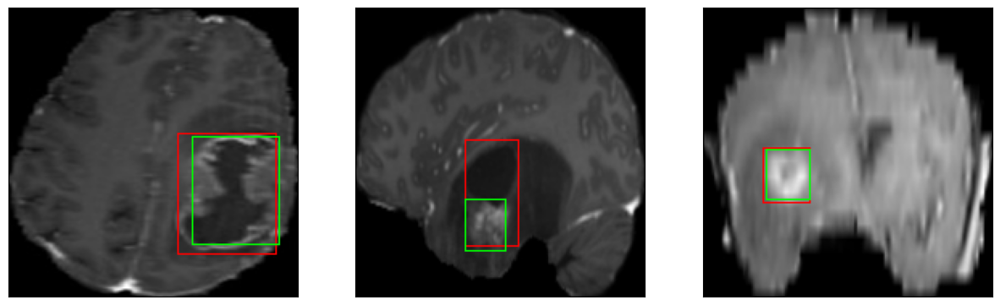

52/52 [==============================] - 7s 133ms/step - loss: 2.5577 - IoU: 0.7812 - val_loss: 5.7650 - val_IoU: 0.6202
Epoch 86/100
52/52 [==============================] - ETA: 0s - loss: 2.5425 - IoU: 0.7789
Epoch 86: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


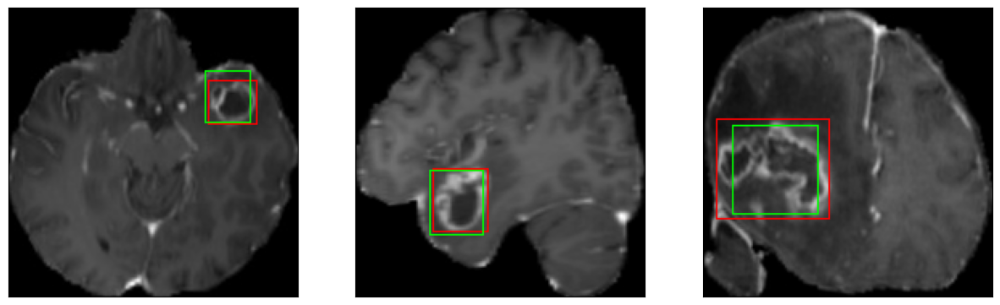

52/52 [==============================] - 8s 150ms/step - loss: 2.5425 - IoU: 0.7789 - val_loss: 5.2632 - val_IoU: 0.6362
Epoch 87/100
52/52 [==============================] - ETA: 0s - loss: 2.5167 - IoU: 0.7889
Epoch 87: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


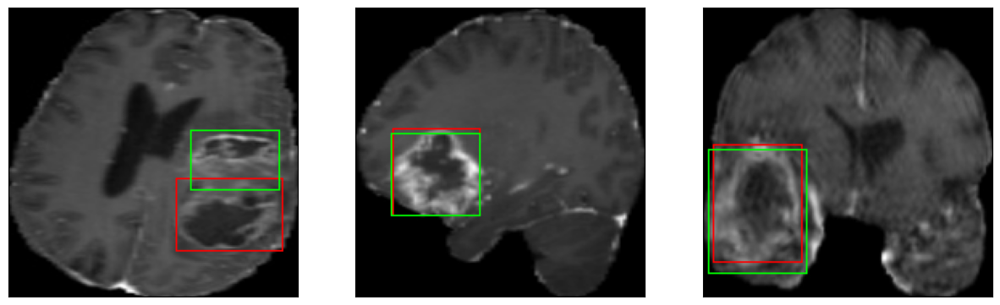

52/52 [==============================] - 7s 127ms/step - loss: 2.5167 - IoU: 0.7889 - val_loss: 5.3024 - val_IoU: 0.6560
Epoch 88/100
52/52 [==============================] - ETA: 0s - loss: 2.5172 - IoU: 0.7872
Epoch 88: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 32ms/step


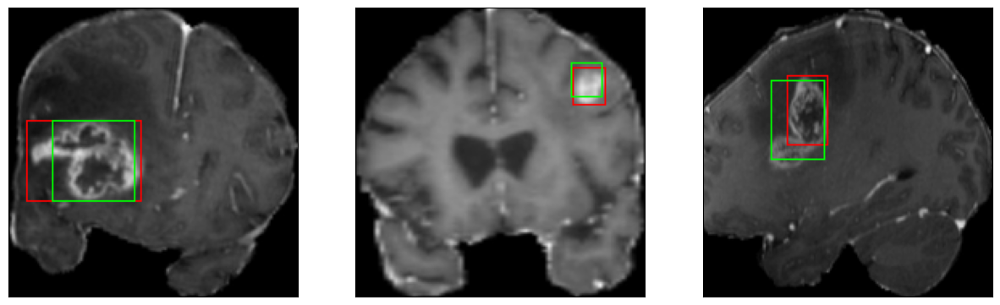

52/52 [==============================] - 8s 145ms/step - loss: 2.5172 - IoU: 0.7872 - val_loss: 5.3115 - val_IoU: 0.6494
Epoch 89/100
52/52 [==============================] - ETA: 0s - loss: 2.5903 - IoU: 0.7846
Epoch 89: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 33ms/step


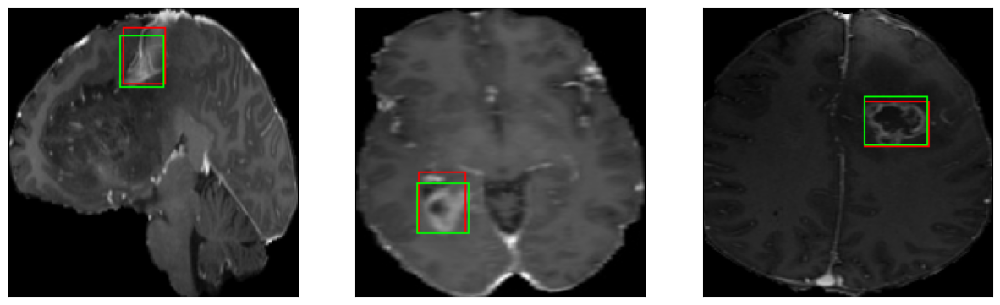

52/52 [==============================] - 7s 136ms/step - loss: 2.5903 - IoU: 0.7846 - val_loss: 5.5619 - val_IoU: 0.6403
Epoch 90/100
52/52 [==============================] - ETA: 0s - loss: 2.4159 - IoU: 0.7988
Epoch 90: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


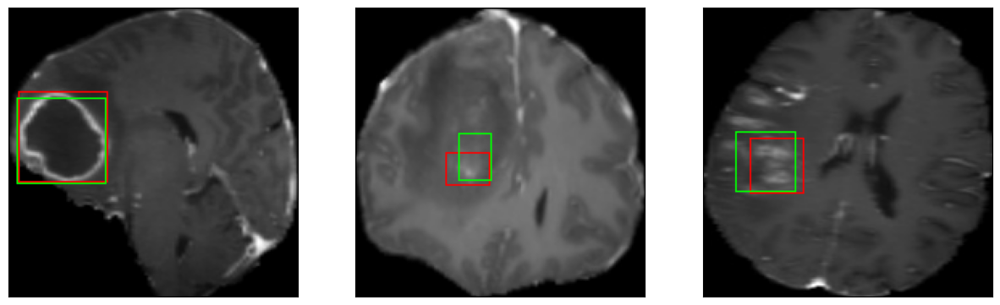

52/52 [==============================] - 6s 121ms/step - loss: 2.4159 - IoU: 0.7988 - val_loss: 5.2247 - val_IoU: 0.6657
Epoch 91/100
52/52 [==============================] - ETA: 0s - loss: 2.4448 - IoU: 0.7867
Epoch 91: val_loss did not improve from 5.21385
8/8 [==============================] - 0s 31ms/step


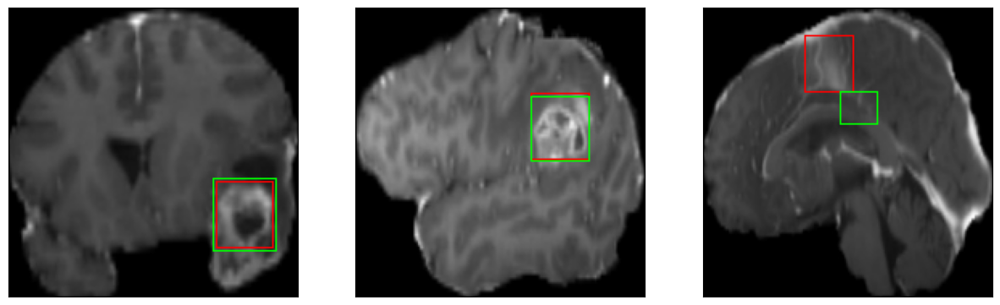

52/52 [==============================] - 7s 137ms/step - loss: 2.4448 - IoU: 0.7867 - val_loss: 5.4946 - val_IoU: 0.6378
Epoch 92/100
52/52 [==============================] - ETA: 0s - loss: 2.3831 - IoU: 0.7947
Epoch 92: val_loss improved from 5.21385 to 5.15229, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


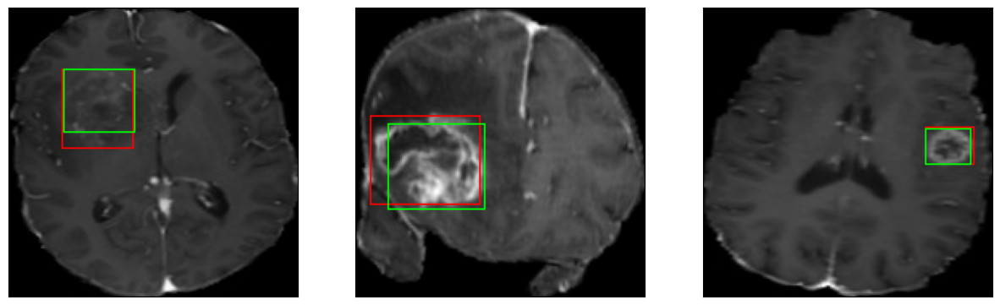

52/52 [==============================] - 9s 183ms/step - loss: 2.3831 - IoU: 0.7947 - val_loss: 5.1523 - val_IoU: 0.6628
Epoch 93/100
52/52 [==============================] - ETA: 0s - loss: 2.4313 - IoU: 0.7909
Epoch 93: val_loss did not improve from 5.15229
8/8 [==============================] - 0s 30ms/step


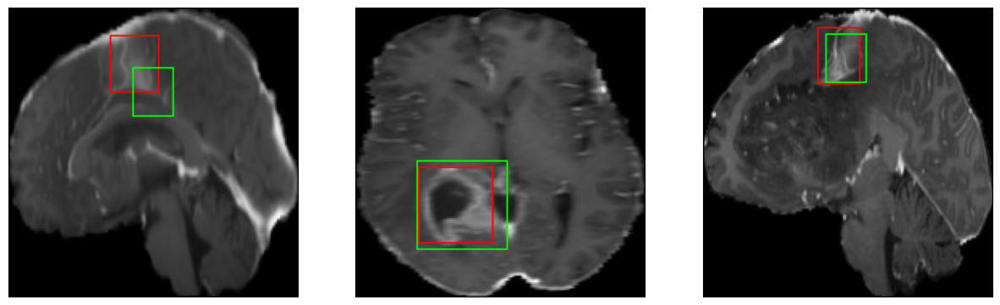

52/52 [==============================] - 7s 127ms/step - loss: 2.4313 - IoU: 0.7909 - val_loss: 5.3822 - val_IoU: 0.6548
Epoch 94/100
52/52 [==============================] - ETA: 0s - loss: 2.3899 - IoU: 0.7949
Epoch 94: val_loss did not improve from 5.15229
8/8 [==============================] - 0s 31ms/step


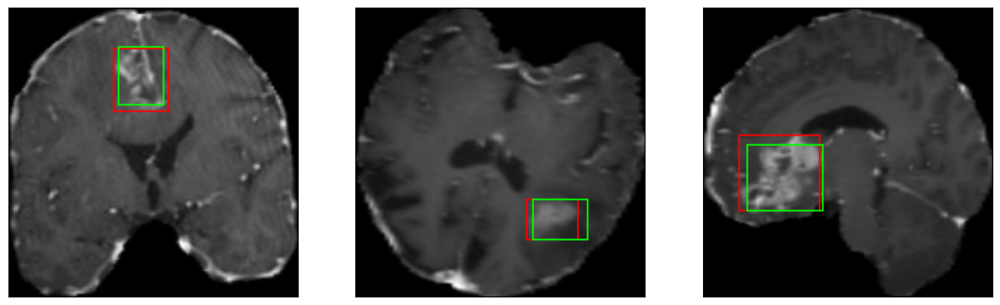

52/52 [==============================] - 8s 145ms/step - loss: 2.3899 - IoU: 0.7949 - val_loss: 5.3651 - val_IoU: 0.6459
Epoch 95/100
52/52 [==============================] - ETA: 0s - loss: 2.3906 - IoU: 0.8006
Epoch 95: val_loss did not improve from 5.15229
8/8 [==============================] - 0s 35ms/step


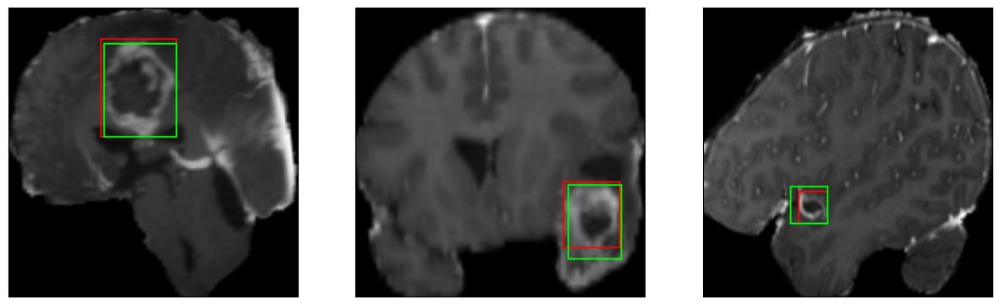

52/52 [==============================] - 7s 133ms/step - loss: 2.3906 - IoU: 0.8006 - val_loss: 5.2321 - val_IoU: 0.6527
Epoch 96/100
52/52 [==============================] - ETA: 0s - loss: 2.3294 - IoU: 0.8043
Epoch 96: val_loss did not improve from 5.15229
8/8 [==============================] - 0s 31ms/step


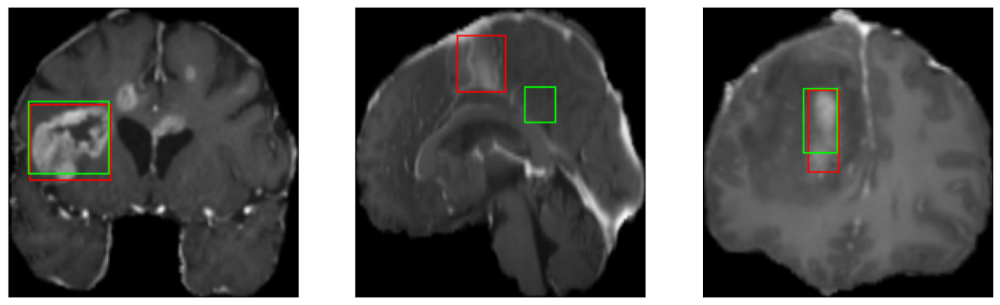

52/52 [==============================] - 6s 122ms/step - loss: 2.3294 - IoU: 0.8043 - val_loss: 5.3279 - val_IoU: 0.6465
Epoch 97/100
52/52 [==============================] - ETA: 0s - loss: 2.3580 - IoU: 0.8003
Epoch 97: val_loss did not improve from 5.15229
8/8 [==============================] - 0s 30ms/step


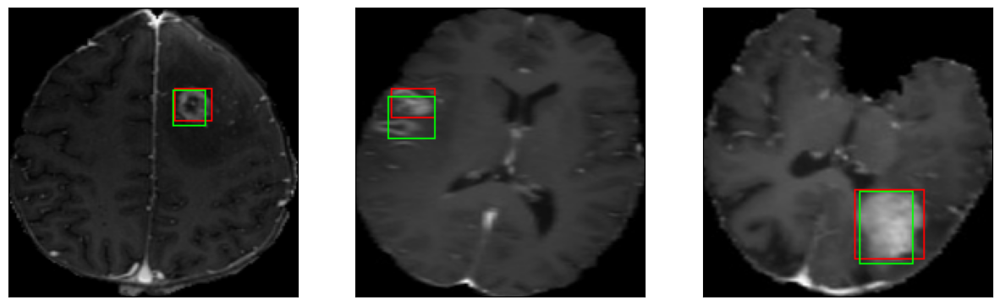

52/52 [==============================] - 7s 135ms/step - loss: 2.3580 - IoU: 0.8003 - val_loss: 5.4148 - val_IoU: 0.6513
Epoch 98/100
52/52 [==============================] - ETA: 0s - loss: 2.3429 - IoU: 0.8078
Epoch 98: val_loss did not improve from 5.15229
8/8 [==============================] - 0s 31ms/step


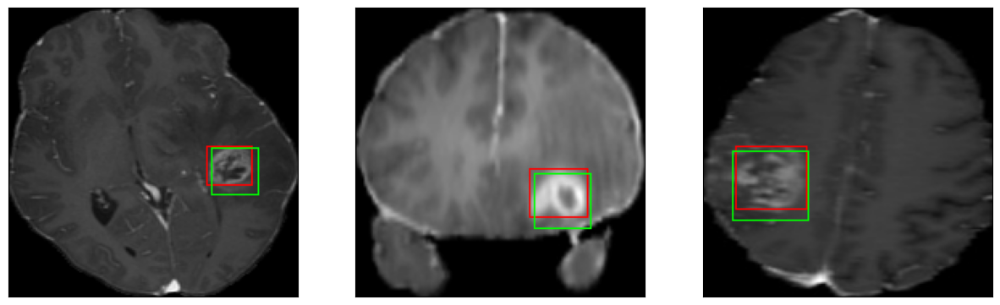

52/52 [==============================] - 7s 138ms/step - loss: 2.3429 - IoU: 0.8078 - val_loss: 5.6761 - val_IoU: 0.6424
Epoch 99/100
52/52 [==============================] - ETA: 0s - loss: 2.3029 - IoU: 0.8103
Epoch 99: val_loss did not improve from 5.15229
8/8 [==============================] - 0s 31ms/step


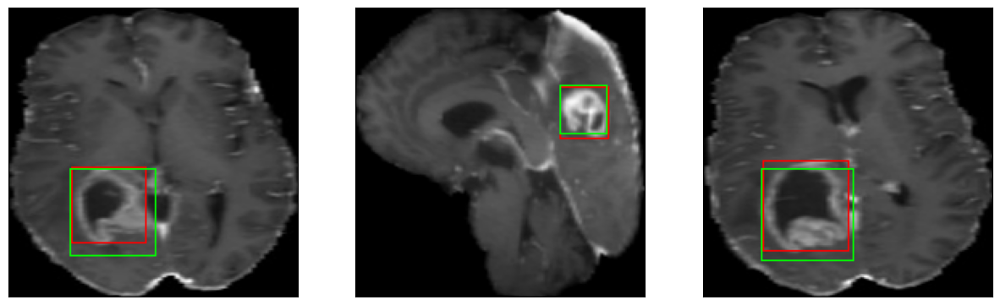

52/52 [==============================] - 7s 131ms/step - loss: 2.3029 - IoU: 0.8103 - val_loss: 5.1752 - val_IoU: 0.6576
Epoch 100/100
52/52 [==============================] - ETA: 0s - loss: 2.2719 - IoU: 0.8064
Epoch 100: val_loss did not improve from 5.15229
8/8 [==============================] - 0s 30ms/step


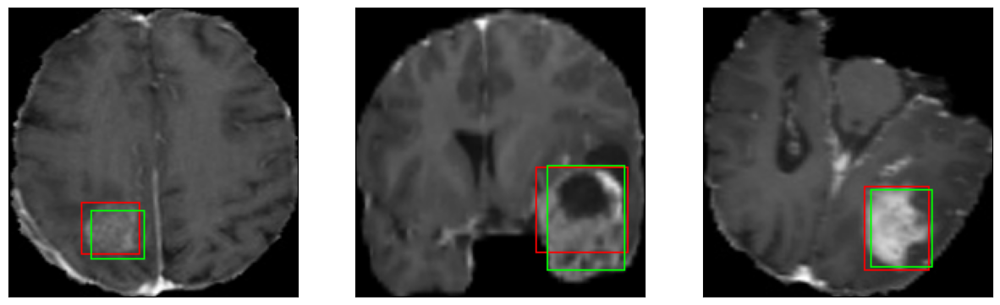

52/52 [==============================] - 7s 127ms/step - loss: 2.2719 - IoU: 0.8064 - val_loss: 5.4605 - val_IoU: 0.6509


In [26]:
model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [ ]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
        
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])


In [27]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_EFFNET/model_EFFNET.h5',compile = False)

In [30]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [31]:
model.evaluate(test_dataset)

15/15 [==============================] - 3s 34ms/step - loss: 5.2661 - IoU: 0.6575


[5.2660813331604, 0.6574758291244507]